# Trabajo del Tema 4

El fichero MD004 - 04 - cancer_reg.csv contiene en formato csv datos de la población de
Estados Unidos. Se trata de construir un modelo de regresión lineal simple para predecir
las tasas de mortalidad por cáncer (target_deathrate) en los condados de los Estados
Unidos:
1. Estudiar gráficamente qué variables parecen tener más relación con la tasa de
mortalidad. Comentad los resultados obtenidos.
2. Escoger dos o tres de ellas, justificar por qué y hacer una regresión lineal simple.
A partir de los resultados del modelo, ¿qué variable da mejor resultado?
3. Dibujar la distribución de los residuos normalizados y el plot de residuos vs valor
predicho. Comentar qué información se puede extraer en relación con la calidad
del ajuste realizado y los requisitos supuestos.
4. ¿Añadirías algún análisis o visualización más para extraer conclusiones?
Entrega:
• fichero Jupyter Notebook con MD004NombreApellidosAC04.ipynb
• fichero .pdf con MD004NombreApellidosAC04.pdf
Plazo: una semana (jueves 01/12/2022 19:00).

In [217]:
install.packages('olsrr')
install.packages('tidyverse')
install.packages('corrplot')
install.packages('ggplot2')

also installing the dependencies ‘nloptr’, ‘pbkrtest’, ‘lme4’, ‘car’


Warning message in install.packages("olsrr"):
“installation of package ‘nloptr’ had non-zero exit status”
Warning message in install.packages("olsrr"):
“installation of package ‘lme4’ had non-zero exit status”
Warning message in install.packages("olsrr"):
“installation of package ‘pbkrtest’ had non-zero exit status”
Warning message in install.packages("olsrr"):
“installation of package ‘car’ had non-zero exit status”
Warning message in install.packages("olsrr"):
“installation of package ‘olsrr’ had non-zero exit status”
Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done

Updating HTML index of packages in '.Library'

Making 'packages.html' ...
 done



In [216]:
library(tidyverse)
library(caret)
library(MASS)
library(lmtest)
library(olsrr)
library(broom)
library(corrplot)
library(ggplot2)

ERROR: Error in library(olsrr): there is no package called ‘olsrr’


In [104]:
data_cancer = read.csv(file = 'MD004 - 04 - cancer_reg.csv', header=TRUE, sep=',', dec='.')

head (data_cancer)



,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,binnedinc,medianage,⋯,pctprivatecoveragealone,pctempprivcoverage,pctpubliccoverage,pctpubliccoveragealone,pctwhite,pctblack,pctasian,pctotherrace,pctmarriedhouseholds,birthrate
,<dbl>,<int>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<fct>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1397,469,164.9,489.8,61898,260131,11.2,499.74820,"(61494.5, 125635]",39.3,⋯,NA,41.6,32.9,14.0,81.78053,2.5947283,4.8218571,1.8434785,52.85608,6.118831
2,173,70,161.3,411.6,48127,43269,18.6,23.11123,"(48021.6, 51046.4]",33.0,⋯,53.8,43.6,31.1,15.3,89.22851,0.9691025,2.2462326,3.7413515,45.37250,4.333096
3,102,50,174.7,349.7,49348,21026,14.6,47.56016,"(48021.6, 51046.4]",45.0,⋯,43.5,34.9,42.1,21.1,90.92219,0.7396734,0.4658982,2.7473583,54.44487,3.729488
4,427,202,194.8,430.4,44243,75882,17.1,342.63725,"(42724.4, 45201]",42.8,⋯,40.3,35.0,45.3,25.0,91.74469,0.7826260,1.1613587,1.3626432,51.02151,4.603841
5,57,26,144.4,350.1,49955,10321,12.5,0.00000,"(48021.6, 51046.4]",48.3,⋯,43.9,35.1,44.0,22.7,94.10402,0.2701920,0.6658304,0.4921355,54.02746,6.796657
6,428,152,176.0,505.4,52313,61023,15.6,180.25990,"(51046.4, 54545.6]",45.4,⋯,38.8,32.6,43.2,20.2,84.88263,1.6532052,1.5380566,3.3146354,51.22036,4.964476


In [208]:
str(data_cancer)

'data.frame':	3047 obs. of  33 variables:
 $ avganncount            : num  1397 173 102 427 57 ...
 $ avgdeathsperyear       : int  469 70 50 202 26 152 97 71 36 1380 ...
 $ target_deathrate       : num  165 161 175 195 144 ...
 $ incidencerate          : num  490 412 350 430 350 ...
 $ medincome              : int  61898 48127 49348 44243 49955 52313 37782 40189 42579 60397 ...
 $ popest2015             : int  260131 43269 21026 75882 10321 61023 41516 20848 13088 843954 ...
 $ povertypercent         : num  11.2 18.6 14.6 17.1 12.5 15.6 23.2 17.8 22.3 13.1 ...
 $ studypercap            : num  499.7 23.1 47.6 342.6 0 ...
 $ binnedinc              : Factor w/ 10 levels "(34218.1, 37413.8]",..: 9 6 6 4 6 7 2 2 3 8 ...
 $ medianage              : num  39.3 33 45 42.8 48.3 45.4 42.6 51.7 49.3 35.8 ...
 $ medianagemale          : num  36.9 32.2 44 42.2 47.8 43.5 42.2 50.8 48.4 34.7 ...
 $ medianagefemale        : num  41.7 33.7 45.8 43.4 48.9 48 43.5 52.5 49.8 37 ...
 $ geography           

In [210]:
data_cancer$binnedinc = NULL
data_cancer$geography = NULL

str(data_cancer)

'data.frame':	3047 obs. of  31 variables:
 $ avganncount            : num  1397 173 102 427 57 ...
 $ avgdeathsperyear       : int  469 70 50 202 26 152 97 71 36 1380 ...
 $ target_deathrate       : num  165 161 175 195 144 ...
 $ incidencerate          : num  490 412 350 430 350 ...
 $ medincome              : int  61898 48127 49348 44243 49955 52313 37782 40189 42579 60397 ...
 $ popest2015             : int  260131 43269 21026 75882 10321 61023 41516 20848 13088 843954 ...
 $ povertypercent         : num  11.2 18.6 14.6 17.1 12.5 15.6 23.2 17.8 22.3 13.1 ...
 $ studypercap            : num  499.7 23.1 47.6 342.6 0 ...
 $ medianage              : num  39.3 33 45 42.8 48.3 45.4 42.6 51.7 49.3 35.8 ...
 $ medianagemale          : num  36.9 32.2 44 42.2 47.8 43.5 42.2 50.8 48.4 34.7 ...
 $ medianagefemale        : num  41.7 33.7 45.8 43.4 48.9 48 43.5 52.5 49.8 37 ...
 $ percentmarried         : num  52.5 44.5 54.2 52.7 57.8 50.4 54.1 52.7 55.9 50 ...
 $ pctnohs18_24           : num  11

In [220]:
data_cancer.cor = cor(data_cancer, method = 'pearson')
round(data_cancer.cor, digits = 2)
corrplot(data_cancer.cor)

,avganncount,avgdeathsperyear,target_deathrate,incidencerate,medincome,popest2015,povertypercent,studypercap,medianage,medianagemale,⋯,pctprivatecoveragealone,pctempprivcoverage,pctpubliccoverage,pctpubliccoveragealone,pctwhite,pctblack,pctasian,pctotherrace,pctmarriedhouseholds,birthrate
avganncount,1.00,0.94,-0.14,0.07,0.27,0.93,-0.14,0.08,-0.02,-0.12,⋯,NA,0.20,-0.17,-0.09,-0.14,0.03,0.44,0.21,-0.11,-0.03
avgdeathsperyear,0.94,1.00,-0.09,0.06,0.22,0.98,-0.07,0.06,-0.02,-0.15,⋯,NA,0.16,-0.13,-0.03,-0.19,0.08,0.44,0.22,-0.16,-0.07
target_deathrate,-0.14,-0.09,1.00,0.45,-0.43,-0.12,0.43,-0.02,0.00,-0.02,⋯,NA,-0.27,0.40,0.45,-0.18,0.26,-0.19,-0.19,-0.29,-0.09
incidencerate,0.07,0.06,0.45,1.00,0.00,0.03,0.01,0.08,0.02,-0.01,⋯,NA,0.15,0.05,0.04,-0.01,0.11,-0.01,-0.21,-0.15,-0.12
medincome,0.27,0.22,-0.43,0.00,1.00,0.24,-0.79,0.04,-0.01,-0.09,⋯,NA,0.75,-0.75,-0.72,0.17,-0.27,0.43,0.08,0.45,-0.01
popest2015,0.93,0.98,-0.12,0.03,0.24,1.00,-0.07,0.06,-0.03,-0.18,⋯,NA,0.16,-0.16,-0.04,-0.19,0.07,0.46,0.24,-0.13,-0.06
povertypercent,-0.14,-0.07,0.43,0.01,-0.79,-0.07,1.00,-0.06,-0.03,-0.21,⋯,NA,-0.68,0.65,0.80,-0.51,0.51,-0.16,0.05,-0.60,-0.01
studypercap,0.08,0.06,-0.02,0.08,0.04,0.06,-0.06,1.00,-0.03,-0.04,⋯,NA,0.10,-0.05,-0.06,0.02,-0.02,0.06,-0.02,-0.05,0.01
medianage,-0.02,-0.02,0.00,0.02,-0.01,-0.03,-0.03,-0.03,1.00,0.13,⋯,NA,-0.04,0.05,0.00,0.04,-0.02,-0.04,-0.03,0.01,-0.01
medianagemale,-0.12,-0.15,-0.02,-0.01,-0.09,-0.18,-0.21,-0.04,0.13,1.00,⋯,NA,-0.21,0.40,0.00,0.40,-0.24,-0.24,-0.27,0.22,-0.10


ERROR: Error in corrplot(data_cancer.cor): could not find function "corrplot"


## Justificación de las variables escogidas

Como se puede observar gracias a la matriz de correlación, no tenemos variables con linealidad respecto a la variable dependiente, dado que ninguna proporciona un valor de 1 o cercano a 1. De todos modos, escogemos las que tienen el valor más elevado y realizaremos los tests para demostrar estadísticamente que no cumplen los requerimientos para utilizar una regresión lineal simple.

Las variables escogidas son las siguientes:

- Variable dependienete (dada por el ejercicio) --> target_deathrate (media de muertes por cancer por cada 100k habitantes)
- Variables predictorias 
    - pctpubliccoveragealone
    - incidencerate
    - povertypercentage
    

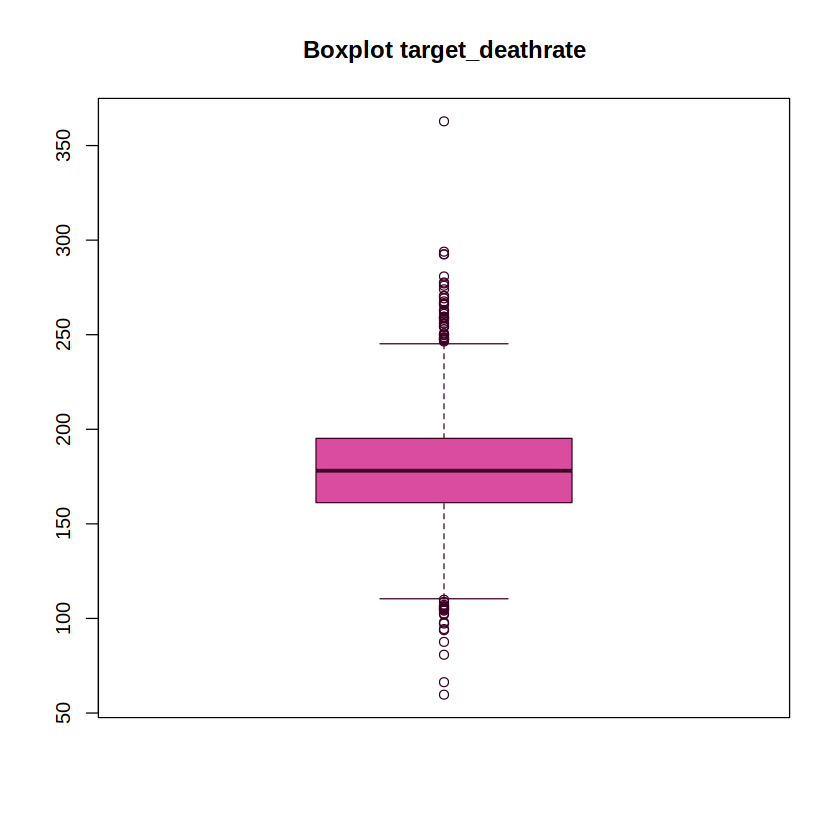

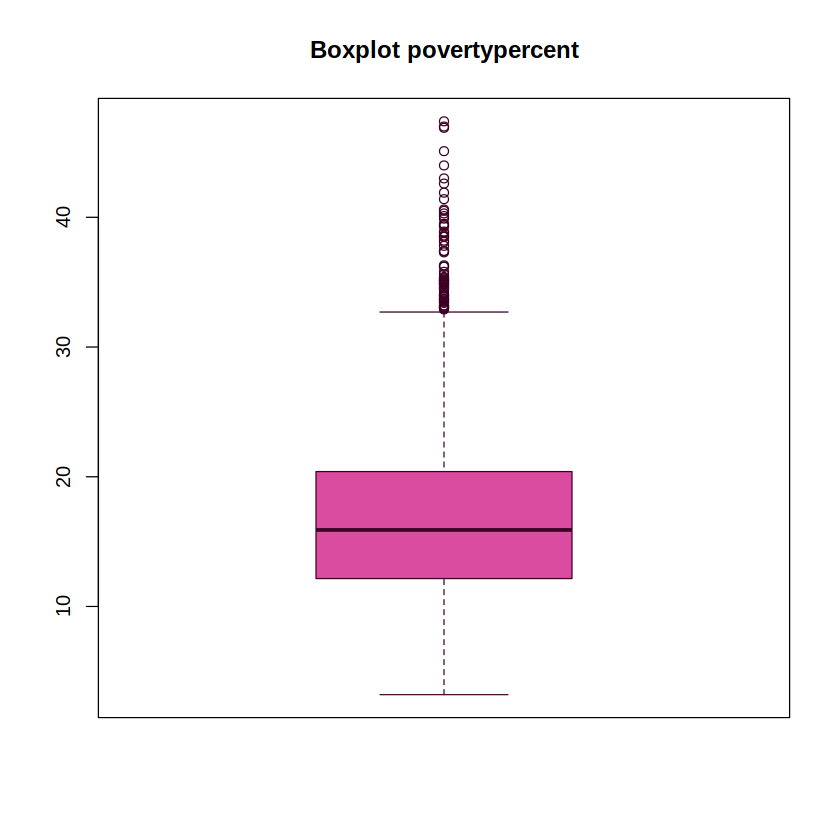

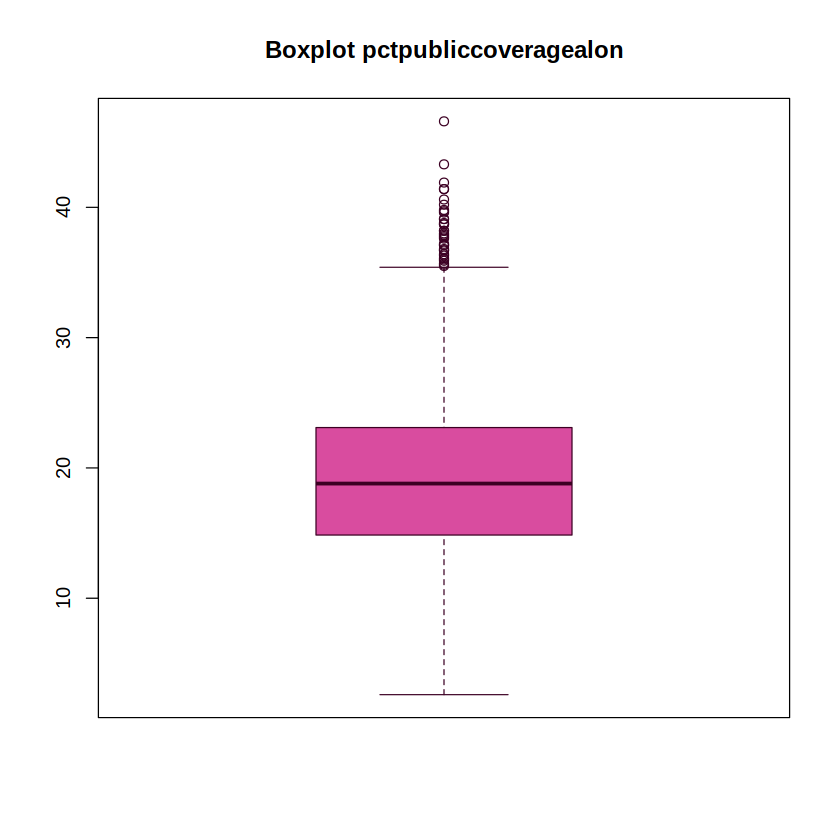

110.4
161.2
178.1
195.2
245.2
177.1268
179.0732


3.20
12.15
15.90
20.40
32.70
15.66386
16.13614


2.60
14.85
18.80
23.10
35.40
18.56386
19.03614


329.9000
420.3000
453.5494
480.8500
570.8000
451.8163
455.2826


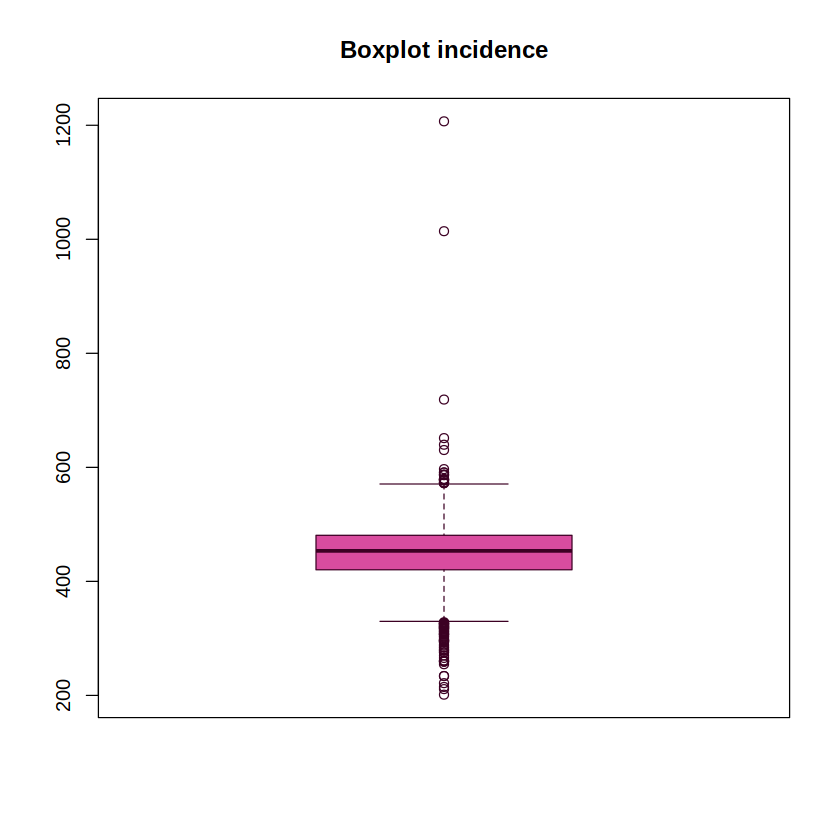

In [105]:
bdeath = boxplot(data_cancer$target_deathrate
        ,col = "#d94c9f"
        ,border="#3c0023"
        ,main = "Boxplot target_deathrate" #título del gráfico
       )
bpoverty = boxplot(data_cancer$povertypercent
        ,col = "#d94c9f"
        ,border="#3c0023"
        ,main = "Boxplot povertypercent" #título del gráfico
       )
bpubliccov = boxplot(data_cancer$pctpubliccoveragealone
        ,col = "#d94c9f"
        ,border="#3c0023"
        ,main = "Boxplot pctpubliccoveragealon" #título del gráfico
       )
bmedi = boxplot(data_cancer$incidencerate
        ,col = "#d94c9f"
        ,border="#3c0023"
        ,main = "Boxplot incidence" #título del gráfico
       )
bdeath
bpoverty
bpubliccov
bmedi


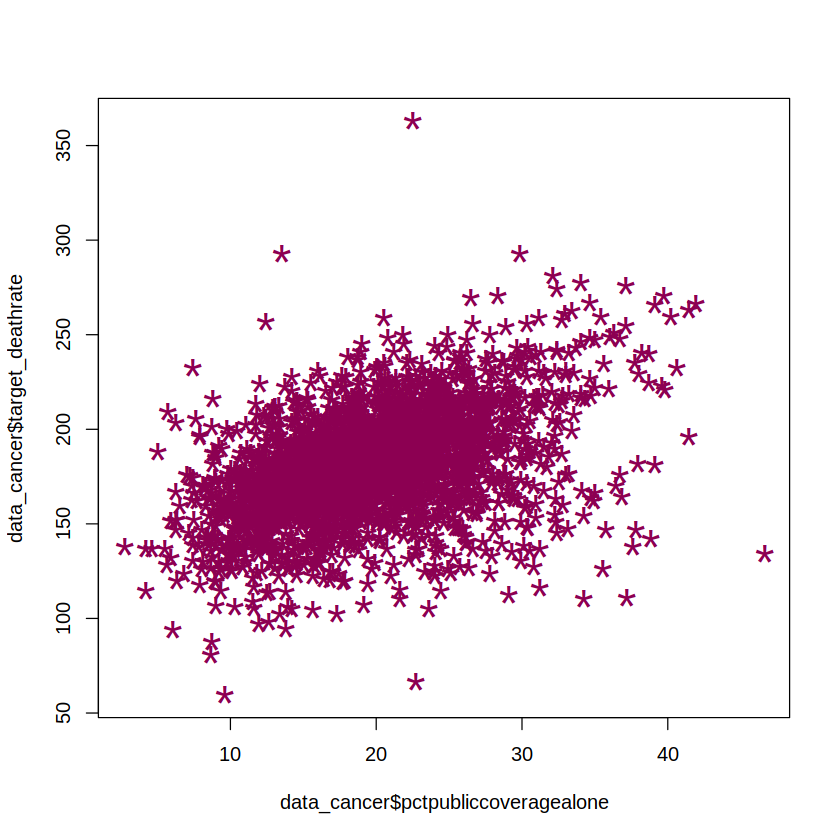

In [90]:
plot(data_cancer$pctpubliccoveragealone,data_cancer$target_deathrate,pch ="*",col ="#8c0052", cex=2.5)

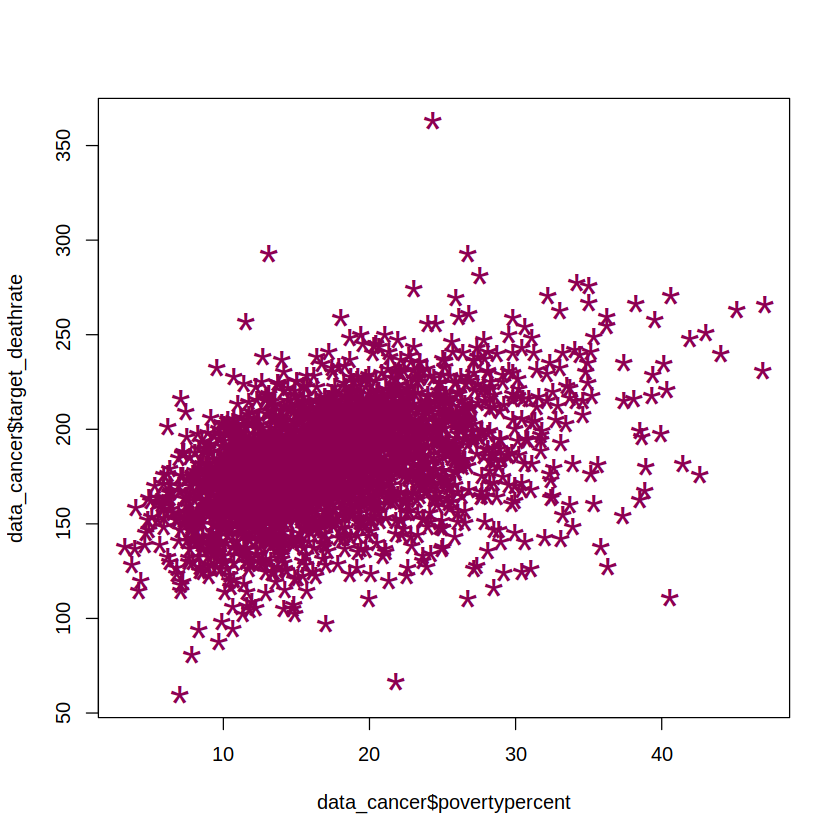

In [99]:
plot(data_cancer$povertypercent,data_cancer$target_deathrate,pch ="*",col ="#8c0052", cex=2.5)

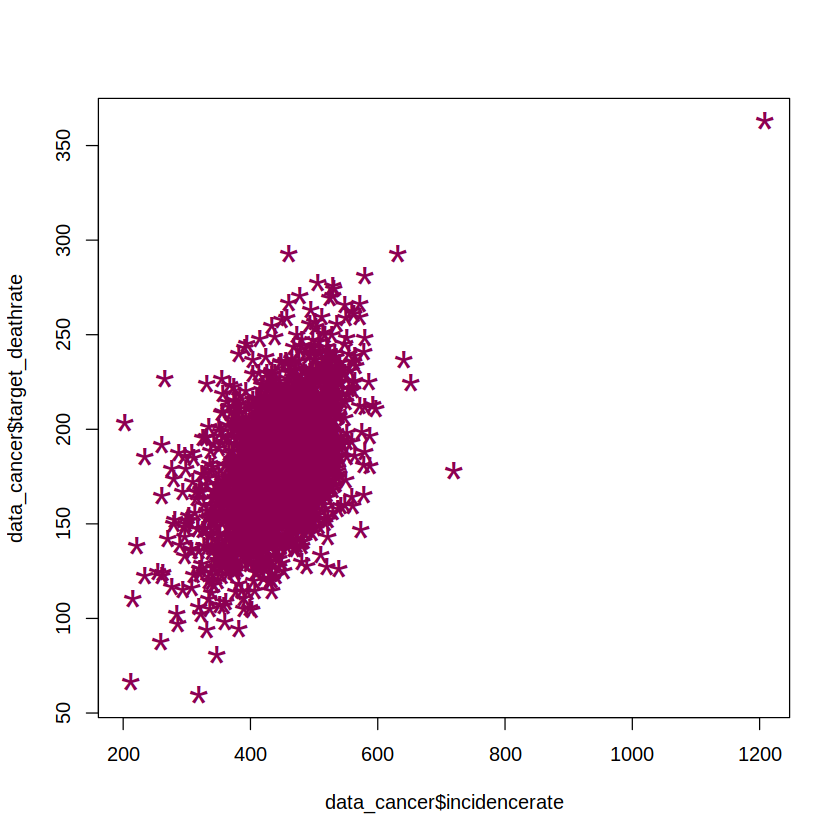

In [102]:
plot(data_cancer$incidencerate,data_cancer$target_deathrate,pch ="*",col ="#8c0052", cex=2.5)

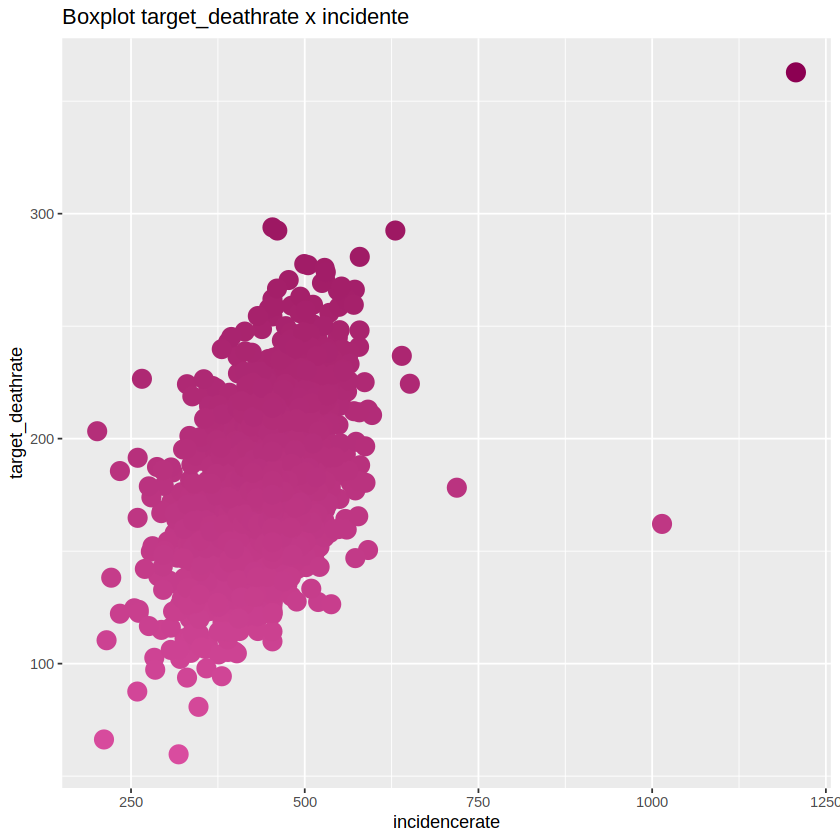

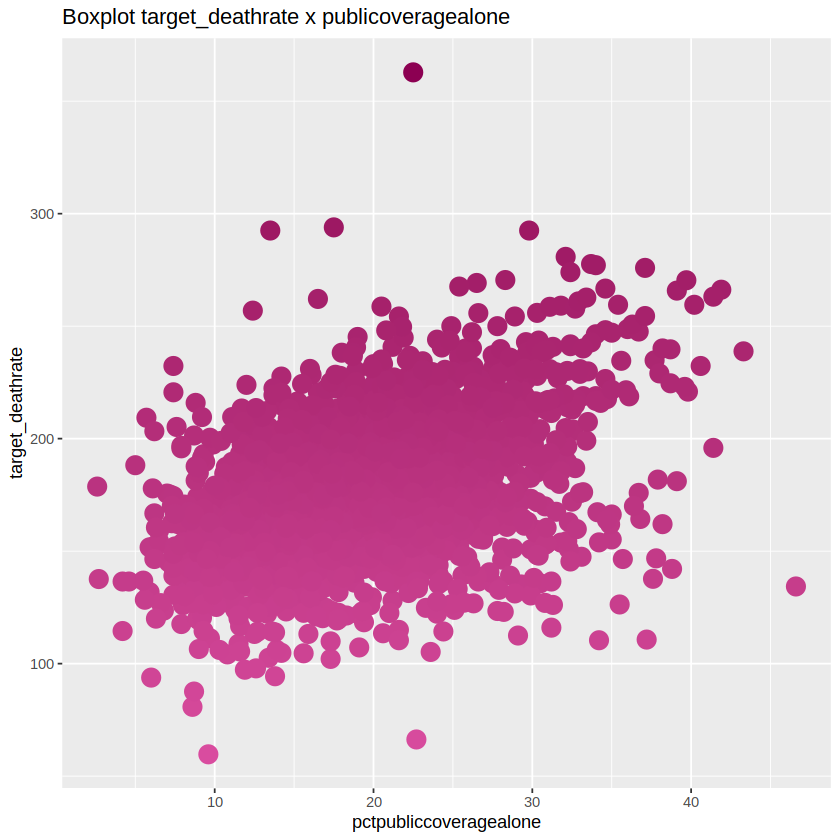

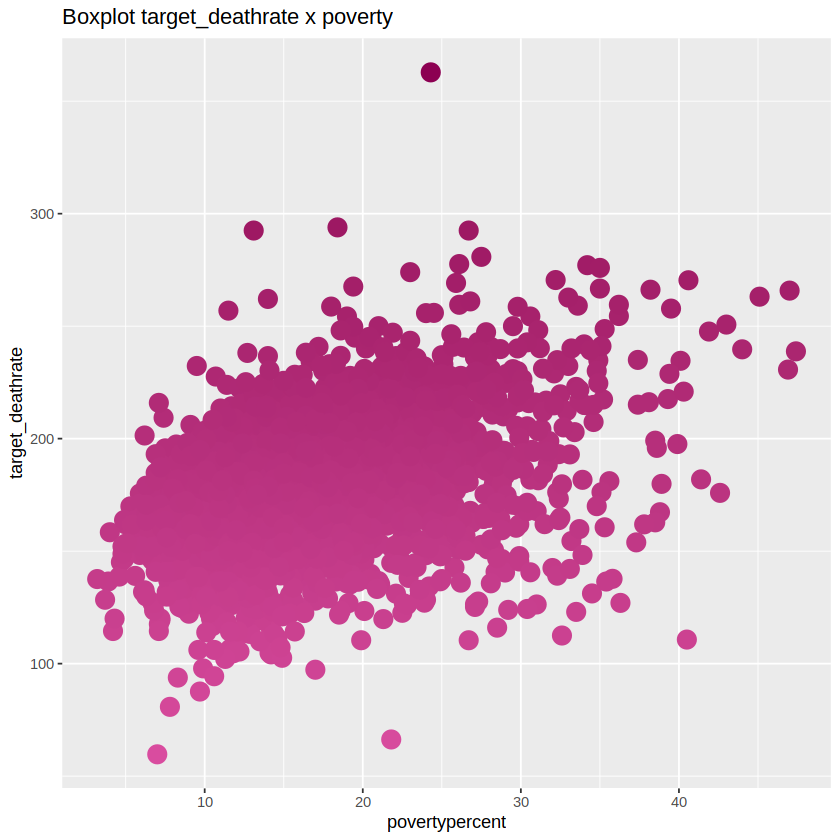

In [221]:
ggplot(data_cancer) +
  aes(x = incidencerate
      ,y = target_deathrate
      ,color = target_deathrate) +
   geom_point(size = 5
             ,show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "Boxplot target_deathrate x incidente " )


ggplot(data_cancer) +
  aes(x = pctpubliccoveragealone
      ,y = target_deathrate
      ,color = target_deathrate) +
   geom_point(size = 5
             ,show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "Boxplot target_deathrate x publicoveragealone " )

ggplot(data_cancer) +
  aes(x = povertypercent
      ,y = target_deathrate
      ,color = target_deathrate) +
   geom_point(size = 5
             ,show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "Boxplot target_deathrate x poverty " )



## Comprovación linealidad

Sabemos que no hay linealidad, gracias a la matriz de correlación pero realizaremos los test para demostrar como no se cumple.

In [115]:
cor.test(data_cancer$target_deathrate , data_cancer$povertypercent)


	Pearson's product-moment correlation

data:  data_cancer$target_deathrate and data_cancer$povertypercent
t = 26.236, df = 3045, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.3999782 0.4579164
sample estimates:
     cor 
0.429389 


In [100]:
cor.test(data_cancer$target_deathrate , data_cancer$incidencerate)


	Pearson's product-moment correlation

data:  data_cancer$target_deathrate and data_cancer$incidencerate
t = 28.052, df = 2465, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.4614069 0.5212587
sample estimates:
      cor 
0.4919137 


In [114]:
cor.test(data_cancer$target_deathrate , data_cancer$pctpubliccoveragealone)


	Pearson's product-moment correlation

data:  data_cancer$target_deathrate and data_cancer$pctpubliccoveragealone
t = 27.756, df = 3045, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.4205588 0.4772517
sample estimates:
      cor 
0.4493576 


### Justificación


Como podemos observar las 3 variables demuestran que no hay que descartar que la correlación es igual a cero, dado que el p value es inferior a 0.05. Pero además podemos ver que el valor de correlación es muy bajo.




## División data set train & test

In [121]:
set.seed(500) # Randomly Split the data into training and test set#puedes no poner el valor de la semilla aleatoria
#pero si quiero reproducir varios casos es muy importante reproducir la misma semilla aleatoria
#incluso es util si quiero comparar con alguien, ambos hemos de haber usado la misma semilla

# Creamos el data partition de la función caret con un 60 - 40 split
inTrain = createDataPartition(y = data_cancer$target_deathrate
                              ,p = 0.6
                              , list = FALSE
                              , times = 1)

data_train  = data_cancer[inTrain, ]
data_test = data_cancer[-inTrain, ]

In [123]:
str(data_train)
str(data_test)

'data.frame':	1830 obs. of  33 variables:
 $ avganncount            : num  1397 173 102 427 428 ...
 $ avgdeathsperyear       : int  469 70 50 202 152 97 71 36 1118 901 ...
 $ target_deathrate       : num  165 161 175 195 176 ...
 $ incidencerate          : num  490 412 350 430 505 ...
 $ medincome              : int  61898 48127 49348 44243 52313 37782 40189 54721 71890 50083 ...
 $ popest2015             : int  260131 43269 21026 75882 61023 41516 20848 16252 772501 490945 ...
 $ povertypercent         : num  11.2 18.6 14.6 17.1 15.6 23.2 17.8 12.7 9.9 16.3 ...
 $ studypercap            : num  499.7 23.1 47.6 342.6 180.3 ...
 $ binnedinc              : Factor w/ 10 levels "(34218.1, 37413.8]",..: 9 6 6 4 7 2 2 8 9 6 ...
 $ medianage              : num  39.3 33 45 42.8 45.4 42.6 51.7 54.4 37.6 37.2 ...
 $ medianagemale          : num  36.9 32.2 44 42.2 43.5 42.2 50.8 54 36.6 35.7 ...
 $ medianagefemale        : num  41.7 33.7 45.8 43.4 48 43.5 52.5 54.6 38.7 38.7 ...
 $ geography     

## Modelo de ajuste

In [130]:
modelo_lm_pov = lm(target_deathrate ~ povertypercent , data = data_train) # Entrenamos el modelo
summary(modelo_lm_pov)


Call:
lm(formula = target_deathrate ~ povertypercent, data = data_train)

Residuals:
     Min       1Q   Median       3Q      Max 
-121.843  -14.439    1.471   15.366  169.928 

Coefficients:
                Estimate Std. Error t value Pr(>|t|)    
(Intercept)    146.90441    1.62939   90.16   <2e-16 ***
povertypercent   1.89168    0.08984   21.06   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 25.37 on 1828 degrees of freedom
Multiple R-squared:  0.1952,	Adjusted R-squared:  0.1948 
F-statistic: 443.4 on 1 and 1828 DF,  p-value: < 2.2e-16


In [182]:
modelo_lm_inc = lm(target_deathrate ~ incidencerate , data = data_train) # Entrenamos el modelo
summary(modelo_lm_inc)


Call:
lm(formula = target_deathrate ~ incidencerate, data = data_train)

Residuals:
    Min      1Q  Median      3Q     Max 
-87.016 -17.311  -1.351  15.625 113.964 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)   68.37092    4.77690   14.31   <2e-16 ***
incidencerate  0.24598    0.01056   23.30   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 24.83 on 1828 degrees of freedom
Multiple R-squared:  0.229,	Adjusted R-squared:  0.2286 
F-statistic:   543 on 1 and 1828 DF,  p-value: < 2.2e-16


In [133]:
modelo_lm_pub = lm(target_deathrate ~ pctpubliccoveragealone , data = data_train) # Entrenamos el modelo
summary(modelo_lm_pub)


Call:
lm(formula = target_deathrate ~ pctpubliccoveragealone, data = data_train)

Residuals:
     Min       1Q   Median       3Q      Max 
-119.622  -13.538    1.335   14.395  177.287 

Coefficients:
                        Estimate Std. Error t value Pr(>|t|)    
(Intercept)            139.46645    1.92321   72.52   <2e-16 ***
pctpubliccoveragealone   2.04649    0.09509   21.52   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 25.26 on 1828 degrees of freedom
Multiple R-squared:  0.2022,	Adjusted R-squared:  0.2017 
F-statistic: 463.2 on 1 and 1828 DF,  p-value: < 2.2e-16


Usando un modelo de regresión lineal simple, vemos que:

- que todos los coeficientes son estádisticamente significativos ya que siempre están por debajo del 0.05
- Los modelos también son estadísticamente significativos ya que el p value del modelo sigue estando muy por debajo del 0.05
- Pero como podemos ver en las 3 variables los valores de R son inferiores todos a 0.25, demostrando la no linealidad de las variables y que solo se puede demostrar que la variación de las variables predictorias respecto a la dependiente solo se puede garantizar en un maximo de un 25%.

In [183]:
attributes(modelo_lm_pov)

$names
 [1] "coefficients"  "residuals"     "effects"       "rank"         
 [5] "fitted.values" "assign"        "qr"            "df.residual"  
 [9] "xlevels"       "call"          "terms"         "model"        

$class
[1] "lm"

In [186]:
attributes(modelo_lm_pub)

$names
 [1] "coefficients"  "residuals"     "effects"       "rank"         
 [5] "fitted.values" "assign"        "qr"            "df.residual"  
 [9] "xlevels"       "call"          "terms"         "model"        

$class
[1] "lm"

In [187]:
attributes(modelo_lm_inc)

$names
 [1] "coefficients"  "residuals"     "effects"       "rank"         
 [5] "fitted.values" "assign"        "qr"            "df.residual"  
 [9] "xlevels"       "call"          "terms"         "model"        

$class
[1] "lm"

In [189]:
modelo_lm_inc$residuals

1            2            3            4            6            7 
-23.95313366  -8.31730382  20.30901161  20.55822558 -16.69046033  -6.06562426 
           8           11           14           15           16           17 
 15.85216301 -48.63547404 -24.43867058  -5.77539396   1.58170994 -20.45362678 
          19           20           22           23           24           26 
-14.41816242 -25.82371439  -0.06971434  11.81768489  23.81459852  30.37243336 
          28           30           32           36           39           40 
  6.72115420  -0.84656051  36.21509164  26.86280878  13.71436070   8.79062104 
          41           43           45           51           52           55 
  5.60630818  14.00077368  42.85886382  17.71348463  47.71596771  36.68813797 
          59           60           62           65           69           71 
 32.04772493  13.77502661 -19.17340400  22.84588010 -30.24805734   9.52683382 
          72           73           75           76           77           78 
  8.86947464  65.21065356   5.43326186  -3.10715118  56.87813045  22.53388262 
          80           81           83           86           87           88 
 -1.34029506  12.34016554   3.15364237 -26.93286332 -22.74213990  -8.88317370 
          91           92           93           96           98          100 
  2.96094647 -20.19084327  37.17909922  27.71728448 -22.64991964 -13.28355665 
         101          102          104          105          107          108 
-26.07428007  13.93472374  15.34396538 -54.55833763   1.81061862 -15.28775690 
         110          111          112          116          117          118 
-27.55523379   0.59270370  31.06387335  82.16387335  -1.23612665  11.56387335 
         120          121          124          126          129          131 
-52.53612665  15.76387335 -58.13612665 -13.93612665 -10.87760426 -25.95474067 
         132          133          134          135          137          138 
  0.27393019 -20.49628507 -23.78366682 -20.13162178 -14.40170939 -13.48478071 
         139          142          143          144          145          146 
-13.21505858 -16.16301354 -12.79971944  -4.54175695 -17.41062049  -8.73458050 
         149          150          152          153          154          155 
-32.21827259 -26.47093840 -38.23335644 -23.28711866 -19.56945904  -0.64546409 
         158          160          163          164          166          168 
-26.66080323 -20.67243523 -14.23733634 -21.30470305  60.33066861   6.17614049 
         170          171          172          173          174          175 
-14.41978690  10.11333951   9.98874127 -34.48393959 -53.78899844   9.96885387 
         179          182          183          189          192          196 
 20.71211545 -29.93238767 -19.26527626 -41.45212995 -16.71345157 -27.84064306 
         199          200          201          202          204          205 
 -9.57921127 -14.11233768  18.31014297 -37.50718612 -23.42150408  17.61940208 
         206          207          208          209          210          211 
  6.42869613  -7.60269563  12.32411292  74.53187520 -21.62992207  10.23968989 
         212          213          215          216          218          219 
 22.02756477 -12.53459797  35.84228314   9.24069360  -3.62988713  21.27924433 
         220          221          222          223          224          227 
 29.04712164  11.33857600   8.16998523 -14.92309362  25.03202032  -6.32446280 
         233          234          235          236          237          238 
 -3.45338896 -10.98689831   7.68700661 -10.71310357  53.74708669  46.35808046 
         240          241          242          243          244          245 
 38.31730195  13.63399280  -6.41544152  -3.58602225   8.91755724  20.26021553 
         246          247          250          255          258          259 
 47.14127943  28.79938703  64.67971998  30.20201522 -30.48786708   6.44452839 
         261          262          263          265          

In [191]:
modelo_lm_pub$residuals

1             2             3             4             6 
-3.217376e+00 -9.477820e+00 -7.947490e+00  4.171181e+00 -4.805644e+00 
            7             8            11            14            15 
-2.230085e+01 -5.186974e+00 -5.551730e+01 -3.022026e+00 -1.226144e+01 
           16            17            19            20            22 
-1.458697e+01  2.396572e+00 -1.514055e+01 -1.177546e+01 -1.590793e+01 
           23            24            26            28            30 
-3.793912e+00  3.122919e+01  4.852583e+00  1.012461e+01  6.922470e+00 
           32            36            39            40            41 
 2.064100e+01  8.987562e+00  2.364321e+01  1.114321e+01  8.854727e+00 
           43            45            51            52            55 
 2.388284e+01  4.783398e+01  1.125022e+01  3.727826e+01  3.482919e+01 
           59            60            62            65            69 
 3.761059e+01 -9.735830e+00 -3.010670e-01  2.550373e+01 -7.998706e+00 
           71            72            73            75            76 
 2.350222e+00 -1.112646e+01  4.758763e+01 -1.759077e+00 -4.218812e-01 
           77            78            80            81            83 
 3.719915e+01  2.028277e+01 -9.949850e+00 -1.074284e+01 -5.810366e+00 
           86            87            88            91            92 
-1.149642e+01 -1.788476e+01  1.073377e+01  1.098727e+01 -1.248712e+01 
           93            96            98           100           101 
 1.117576e+01 -3.584758e+00 -1.481494e+01 -9.308077e+00 -5.584902e+00 
          102           104           105           107           108 
-5.994057e+00 -2.664298e+01 -5.364756e+01 -1.775221e+01  2.747644e+00 
          110           111           112           116           117 
-1.298941e+01  1.494211e+00  3.612919e+01  8.886639e+01  3.391266e+01 
          118           120           121           124           126 
 2.829421e+01 -4.378712e+01  1.714550e+01 -5.675450e+01 -5.391768e+00 
          129           131           132           133           134 
 8.752438e+00 -2.656933e+00 -3.912582e+00 -1.311738e+01 -2.256933e+00 
          135           137           138           139           142 
 6.824469e+00  1.275702e+01  5.082319e-01  3.810593e+00  5.268748e+00 
          143           144           145           146           149 
 1.925244e+01  1.017676e+00 -2.084749e+01  2.783842e+01 -8.840624e+00 
          150           152           153           154           155 
-7.529036e+00 -4.515160e+00 -4.149850e+00 -3.152882e+01  1.706410e+01 
          158           160           163           164           166 
-1.886151e+01 -4.168697e+01 -6.602631e+01 -5.297996e+01  4.192011e+01 
          168           170           171           172           173 
-1.225679e+01 -3.800564e+01 -4.479377e+01 -1.849398e+01 -7.295900e+01 
          174           175           179           182           183 
-3.356173e+01 -3.522860e+01 -1.870665e+00 -4.694749e+01 -5.270092e+01 
          189           192           196           199           200 
-5.047746e+01  7.573325e+00 -9.835902e+00  5.385620e-01 -1.733541e+00 
          201           202           204           205           206 
 9.301366e+00 -4.801745e+01 -1.236394e+01  6.657088e+00  4.006624e+01 
          207           208           209           210           211 
 2.030587e+01  1.941288e+01  3.091074e+01 -1.238033e+01  2.226868e+01 
          212           213           215           216           218 
 4.082768e+00 -4.047562e+00  3.289436e+01  4.226166e+01  2.372683e+01 
          219           220           221           222           223 
 4.412905e+01  4.547576e+01  2.340587e+01  1.189443e+01  5.703582e+00 
          224           227           233           234           235 
 2.269199e+01  2.089879e+01  1.012939e-01 -9.761583e+00 -1.219177e+01 
          236           237           238           240           241 
-9.970882e+00  2.444092e+01  1.427111e+01  1.320373e+01  8.157088e+00 
          242           243         

In [193]:
modelo_lm_pov$residuals

1             2             3             4             6 
-3.191227e+00 -2.078966e+01  1.770601e-01  1.554786e+01 -4.146201e-01 
            7             8            11            14            15 
-1.489139e+01  3.023684e+00 -4.952875e+01 -3.320432e-01 -6.738796e+00 
           16            17            19            20            22 
-9.213837e+00  4.845965e-01 -1.380379e+01 -1.330379e+01 -1.628385e+01 
           23            24            26            28            30 
 2.124467e+00  3.422541e+01  7.400291e+00  5.667795e+00  1.851442e+01 
           32            36            39            40            41 
 2.961364e+01  2.509197e+01  3.350124e+01  1.570453e+01  1.200045e+01 
           43            45            51            52            55 
 3.366199e+01  5.498365e+01  2.103954e+01  4.073938e+01  3.820375e+01 
           59            60            62            65            69 
 3.518287e+01 -3.397980e+00  5.678789e+00  3.431285e+01 -1.115214e+01 
           71            72            73            75            76 
 5.329491e+00 -9.380128e-01  6.322274e+01  4.944832e-01  6.058692e+00 
           77            78            80            81            83 
 4.536528e+01  2.542368e+01 -4.420428e+00 -9.312598e-01 -3.670513e-01 
           86            87            88            91            92 
-7.045387e+00 -1.957129e+01  1.304880e+01  1.326796e+01 -9.012891e+00 
           93            96            98           100           101 
 1.960124e+01  7.820843e-01 -1.266297e+01 -4.962027e+00 -1.011619e+01 
          102           104           105           107           108 
-7.271292e+00 -2.610787e+01 -4.694539e+01 -1.387208e+01 -1.702843e+00 
          110           111           112           116           117 
-8.228748e+00 -2.256219e+00  3.912541e+01  8.871207e+01  1.325712e+01 
          118           120           121           124           126 
 2.435461e+01 -4.806878e+01  2.287957e+01 -6.010049e+01 -1.003628e+01 
          129           131           132           133           134 
 1.677879e+01 -6.426236e+00  6.509556e+00 -1.384790e+01 -1.620270e-01 
          135           137           138           139           142 
 8.224629e+00  8.373764e+00  5.322117e+00  4.031220e+00  1.130375e+01 
          143           144           145           146           149 
 2.160375e+01  5.807827e+00 -1.669547e+01  3.108381e+01 -8.926236e+00 
          150           152           153           154           155 
-5.905355e+00 -6.062810e+00  4.784596e+00 -2.223299e+01  2.311458e+01 
          158           160           163           164           166 
-1.230206e+01 -3.517883e+01 -5.488480e+01 -4.578385e+01  5.772698e+01 
          168           170           171           172           173 
-2.777100e+00 -5.290976e+01 -2.695057e+01 -1.210630e+01 -6.152718e+01 
          174           175           179           182           183 
-4.034947e+01 -2.298982e+01 -1.515565e+00 -3.503958e+01 -4.992969e+01 
          189           192           196           199           200 
-3.481478e+01  3.657908e+00 -9.649628e+00  2.467012e+00  1.804532e+00 
          201           202           204           205           206 
 8.516147e+00 -6.322294e+01 -1.284868e+01  5.398724e+00  3.460799e+01 
          207           208           209           210           211 
 2.384880e+01  1.777957e+01  2.697690e+01 -1.778196e+01  2.234127e+01 
          212           213           215           216           218 
 5.219549e-01 -3.720756e-01  2.688114e+01  3.275540e+01  2.204708e+01 
          219           220           221           222           223 
 4.276717e+01  3.952447e+01  1.654456e+01  8.627763e+00  1.015461e+01 
          224           227           233           234           235 
 2.032620e+01  1.476466e+01 -7.970509e+00 -6.516187e+00 -1.229625e+01 
          236           237           238           240           241 
-1.293707e+01  3.123452e+01  9.848643e+00  1.822949e+01  5.952884e+00 
          242           243         

In [195]:
modelo_lm_mult$fitted.values #Esta es nuestra predicción

1        2        3        4        6        7        8       11 
177.0806 167.9609 154.7701 180.3396 191.6437 197.9989 173.9906 164.9296 
      14       15       16       17       19       20       22       23 
176.6187 178.3453 180.2803 178.9800 175.5526 185.5723 176.8872 189.9759 
      24       26       28       30       32       36       39       40 
176.2157 178.2985 194.7685 234.2448 194.0293 201.3340 191.1701 186.9486 
      41       43       45       51       52       55       59       60 
161.0180 214.2387 206.5144 183.7498 216.5230 167.1179 179.1970 168.1650 
      62       65       69       71       72       73       75       76 
179.3004 197.1656 196.4168 186.9676 186.2146 219.5574 188.1921 191.9349 
      77       78       80       81       83       86       87       88 
194.2675 187.5629 166.4215 158.3463 153.7734 176.4737 177.6849 170.1668 
      91       92       93       96       98      100      101      102 
163.2057 168.8040 154.6959 139.5884 189.8717 157.7313 158.8587 154.5372 
     104      105      107      108      110      111      112      116 
110.1302 165.8046 148.2260 153.5788 183.7012 150.3628 173.9658 174.0430 
     117      118      120      121      124      126      129      131 
155.7704 165.6301 174.2478 176.2845 181.4858 174.6716 182.9731 176.3532 
     132      133      134      135      137      138      139      142 
182.2722 164.7225 171.2980 178.5432 179.1666 174.4716 188.6576 193.2540 
     143      144      145      146      149      150      152      153 
198.1202 201.0108 180.8148 185.4603 181.7344 166.6209 163.6396 191.0434 
     154      155      158      160      163      164      166      168 
185.7718 190.0924 173.7191 174.9894 190.6474 172.6244 198.1083 164.2255 
     170      171      172      173      174      175      179      182 
168.7270 180.9388 159.6677 170.6889 140.1276 205.3938 184.4269 163.3685 
     183      189      192      196      199      200      201      202 
166.4704 233.5425 183.5630 193.7342 196.3052 195.0770 182.8381 138.1691 
     204      205      206      207      208      209      210      211 
154.5110 158.5821 167.4501 179.8757 171.1408 168.3835 130.4683 169.9515 
     212      213      215      216      218      219      220      221 
177.5180 174.7940 183.3986 187.3034 189.3417 158.0679 203.5673 170.6647 
     222      223      224      227      233      234      235      236 
205.9283 181.4443 173.2408 158.8110 181.3307 151.6087 144.8508 155.5281 
     237      238      240      241      242      243      244      245 
164.4136 156.6413 172.7368 164.3771 160.8554 155.1695 167.0712 199.7345 
     246      247      250      255      258      259      261      262 
168.5123 160.4073 168.6033 211.5142 176.8201 213.4596 192.3832 200.7751 
     263      265      266      269      270      271      272      274 
184.2789 207.4890 195.5297 192.7493 191.6345 243.0879 152.5087 192.9735 
     279      280      281      283      285      286      287      289 
176.5740 156.7570 212.0162 159.7450 161.7993 176.9890 173.8563 164.2299 
     290      293      296      297      299      300      301      303 
190.5796 172.4307 180.1323 202.9891 184.7404 169.8750 174.9133 139.0749 
     305      307      308      309      310      311      312      313 
162.9402 157.1946 179.5209 205.1680 189.1717 156.4456 183.9380 180.3613 
     314      315      316      318      319      320      323      324 
165.7432 160.5467 174.2451 169.8832 175.1182 155.0417 180.9732 187.0363 
     325      326      328      329      330      332      334      340 
180.0056 149.3673 175.7473 146.9513 169.0350 170.1460 183.1938 165.2091 
     341      345      348      349      352      353      354      356 
174.8867 198.8525 167.7308 177.7311 173.5319 176.4568 152.5436 197.7343 
     358      359      360      364      365      366      367      371 
182.4354 171.0922 158.4188 177.0858 170.5873 212.0686 202.2268 188.3958 
     373      374      375      376      377      382      385   

In [197]:
modelo_lm_pub$fitted.values

1        2        3        4        6        7        8       11 
168.1174 170.7778 182.6475 190.6288 180.8056 198.2009 188.7870 176.9173 
      14       15       16       17       19       20       22       23 
168.3220 183.2614 188.7870 167.5034 177.9406 175.0755 185.3079 193.4939 
      24       26       28       30       32       36       39       40 
174.8708 191.4474 183.8754 205.9775 196.3590 203.1124 183.0568 183.0568 
      41       43       45       51       52       55       59       60 
169.3453 194.5172 192.2660 187.1498 203.5217 174.8708 175.6894 186.5358 
      62       65       69       71       72       73       75       76 
171.8011 189.1963 176.0987 187.1498 194.9265 211.9124 187.5591 185.9219 
      77       78       80       81       83       86       87       88 
198.2009 185.7172 178.3499 182.4428 172.2104 171.5964 175.4848 165.8662 
      91       92       93       96       98      100      101      102 
167.9127 171.1871 181.6242 175.4848 181.2149 167.7081 157.8849 175.8941 
     104      105      107      108      110      111      112      116 
164.8430 173.8476 174.0522 156.4524 175.6894 163.2058 174.8708 173.2336 
     117      118      120      121      124      126      129      131 
144.7873 163.2058 171.1871 178.5545 178.5545 171.3918 173.8476 165.4569 
     132      133      134      135      137      138      139      142 
185.5126 168.1174 165.4569 166.2755 164.8430 171.3918 175.6894 177.5313 
     143      144      145      146      149      150      152      153 
173.8476 188.5823 182.6475 165.6616 169.1406 164.2290 154.8152 178.3499 
     154      155      158      160      163      164      166      168 
190.6288 177.7359 174.4615 188.7870 212.5263 192.8800 201.6799 183.0568 
     170      171      172      173      174      175      179      182 
180.8056 211.0938 184.6940 196.3590 148.0617 217.0286 192.4707 182.6475 
     183      189      192      196      199      200      201      202 
189.4009 214.7775 168.5267 177.7359 183.2614 182.0335 184.8986 159.3174 
     204      205      206      207      208      209      210      211 
161.3639 173.6429 155.6338 167.0941 171.1871 193.2893 148.8803 168.7313 
     212      213      215      216      218      219      220      221 
185.7172 173.8476 180.8056 164.6383 170.5732 157.2710 181.6242 167.0941 
     222      223      224      227      233      234      235      236 
189.6056 171.5964 176.5080 154.2012 176.0987 165.6616 171.3918 166.0709 
     237      238      240      241      242      243      244      245 
187.5591 181.8289 189.1963 173.6429 158.7035 153.7919 174.4615 187.9684 
     246      247      250      255      258      259      261      262 
187.7637 163.4104 186.3312 182.8521 165.0476 191.6521 185.1033 167.2988 
     263      265      266      269      270      271      272      274 
173.0290 184.2847 172.8243 177.7359 188.9916 193.2893 152.7687 166.4802 
     279      280      281      283      285      286      287      289 
170.3685 158.2942 180.6010 170.1639 182.8521 178.5545 173.8476 174.8708 
     290      293      296      297      299      300      301      303 
193.0846 197.5869 199.2241 188.9916 181.8289 165.4569 180.8056 162.5918 
     305      307      308      309      310      311      312      313 
177.9406 167.2988 172.6197 191.2428 183.6707 184.0800 170.3685 179.3731 
     314      315      316      318      319      320      323      324 
178.1452 173.6429 175.8941 179.3731 187.3544 179.7824 171.3918 184.6940 
     325      326      328      329      330      332      334      340 
173.0290 181.6242 168.1174 167.9127 175.2801 193.0846 170.1639 166.8895 
     341      345      348      349      352      353      354      356 
187.9684 188.9916 187.1498 188.9916 181.6242 178.3499 163.8197 186.1265 
     358      359      360      364      365      366      367      371 
174.2569 181.0103 180.8056 184.6940 160.3407 192.6753 183.8754 192.8800 
     373      374      375      376      377      382      385   

In [200]:
modelo_lm_pov$fitted.values

1        2        3        4        6        7        8       11 
168.0912 182.0897 174.5229 179.2521 176.4146 190.7914 180.5763 170.9287 
      14       15       16       17       19       20       22       23 
165.6320 177.7388 183.4138 169.4154 176.6038 176.6038 185.6839 187.5755 
      24       26       28       30       32       36       39       40 
171.8746 188.8997 188.3322 194.3856 187.3864 187.0080 173.1988 178.4955 
      41       43       45       51       52       55       59       60 
166.1995 184.7380 185.1163 177.3605 200.0606 171.4963 178.1171 180.1980 
      62       65       69       71       72       73       75       76 
165.8212 180.3871 179.2521 184.1705 184.7380 196.2773 185.3055 179.4413 
      77       78       80       81       83       86       87       88 
190.0347 180.5763 172.8204 172.6313 166.7671 167.1454 177.1713 163.5512 
      91       92       93       96       98      100      101      102 
165.6320 167.7129 173.1988 171.1179 179.0630 163.3620 162.4162 177.1713 
     104      105      107      108      110      111      112      116 
164.3079 167.1454 170.1721 160.9028 170.9287 166.9562 171.8746 173.3879 
     117      118      120      121      124      126      129      131 
165.4429 167.1454 175.4688 172.8204 181.9005 176.0363 165.8212 169.2262 
     132      133      134      135      137      138      139      142 
175.0904 168.8479 163.3620 164.8754 169.2262 166.5779 175.4688 171.4963 
     143      144      145      146      149      150      152      153 
171.4963 183.7922 178.4955 162.4162 169.2262 162.6054 156.3628 169.4154 
     154      155      158      160      163      164      166      168 
181.3330 171.6854 167.9021 182.2788 201.3848 185.6839 185.8730 173.5771 
     170      171      172      173      174      175      179      182 
195.7098 193.2506 178.3063 184.9272 154.8495 204.7898 192.1156 170.7396 
     183      189      192      196      199      200      201      202 
186.6297 199.1148 172.4421 177.5496 181.3330 178.4955 185.6839 174.5229 
     204      205      206      207      208      209      210      211 
161.8487 174.9013 161.0920 163.5512 172.8204 197.2231 154.2820 168.6587 
     212      213      215      216      218      219      220      221 
189.2780 170.1721 186.8189 174.1446 172.2529 158.6328 187.5755 173.9554 
     222      223      224      227      233      234      235      236 
192.8722 167.1454 178.8738 160.3353 184.1705 162.4162 171.4963 169.0371 
     237      238      240      241      242      243      244      245 
180.7655 186.2514 184.1705 175.8471 164.3079 158.0653 171.3071 192.1156 
     246      247      250      255      258      259      261      262 
183.2247 168.2804 188.3322 179.4413 168.6587 191.5481 189.4672 178.6846 
     263      265      266      269      270      271      272      274 
175.6579 183.7922 194.1964 191.1697 187.7647 195.7098 158.0653 208.1948 
     279      280      281      283      285      286      287      289 
172.6313 163.1729 174.5229 172.2529 177.7388 174.5229 173.3879 165.6320 
     290      293      296      297      299      300      301      303 
176.2255 189.2780 176.7930 183.9813 173.5771 168.2804 184.5488 165.8212 
     305      307      308      309      310      311      312      313 
174.9013 165.4429 168.8479 187.5755 181.9005 186.4405 165.2537 181.9005 
     314      315      316      318      319      320      323      324 
178.3063 182.2788 173.5771 175.6579 182.8463 179.6305 182.6572 179.8196 
     325      326      328      329      330      332      334      340 
175.8471 170.9287 167.9021 163.7404 174.3338 185.8730 170.1721 169.4154 
     341      345      348      349      352      353      354      356 
177.3605 184.7380 184.9272 187.3864 185.6839 171.8746 164.1187 186.0622 
     358      359      360      364      365      366      367      371 
173.0096 181.9005 174.7121 178.1171 173.9554 192.4939 182.8463 181.9005 
     373      374      375      376      377      382      385   

In [201]:
modelo_lm_inc$fitted.values

1        2        3        4        6        7        8       11 
188.8531 169.6173 154.3910 174.2418 192.6905 181.9656 167.7478 170.0355 
      14       15       16       17       19       20       22       23 
189.7387 176.7754 172.6183 190.3536 177.2182 189.1237 169.4697 177.8823 
      24       26       28       30       32       36       39       40 
182.2854 165.9276 187.2788 213.7466 180.7849 185.2372 192.9856 185.4094 
      41       43       45       51       52       55       59       60 
172.5937 204.3992 197.2411 180.6865 193.0840 173.0119 181.2523 163.0250 
      62       65       69       71       72       73       75       76 
190.6734 191.8541 198.3481 179.9732 174.9305 194.2893 180.3667 188.6072 
      77       78       80       81       83       86       87       88 
178.5219 183.4661 169.7403 159.3598 163.2464 187.0329 180.3421 185.4832 
      91       92       93       96       98      100      101      102 
175.9391 178.8908 155.6209 144.1827 189.0499 171.6836 178.3743 155.9653 
     104      105      107      108      110      111      112      116 
122.8560 174.7583 154.4894 174.4878 190.2552 164.1073 179.9361 179.9361 
     117      118      120      121      124      126      129      131 
179.9361 179.9361 179.9361 179.9361 179.9361 179.9361 193.4776 188.7547 
     132      133      134      135      137      138      139      142 
181.3261 175.4963 186.9837 193.2316 192.0017 185.3848 192.7151 198.9630 
     143      144      145      146      149      150      152      153 
205.8997 194.1418 179.2106 202.2346 192.5183 183.1709 188.5334 197.4871 
     154      155      158      160      163      164      166      168 
178.6695 195.4455 182.2608 167.7724 160.7373 161.2047 183.2693 164.6239 
     170      171      172      173      174      175      179      182 
157.2198 156.1867 156.2113 157.8839 168.2890 171.8311 169.8879 165.6324 
     183      189      192      196      199      200      201      202 
155.9653 205.7521 192.8135 195.7406 193.3792 194.4123 175.8899 148.8072 
     204      205      206      207      208      209      210      211 
172.4215 162.6806 189.2713 195.0027 178.2759 149.6681 158.1299 180.7603 
     212      213      215      216      218      219      220      221 
167.7724 182.3346 177.8577 197.6593 197.9299 180.1208 198.0529 179.1614 
     222      223      224      227      233      234      235      236 
193.3300 192.2231 174.1680 181.4245 179.6534 166.8869 151.5130 166.8131 
     237      238      240      241      242      243      244      245 
158.2529 149.7419 164.0827 168.1660 178.9154 179.1860 173.2824 188.1398 
     246      247      250      255      258      259      261      262 
160.9587 173.7006 158.7203 210.5980 189.7879 200.9555 183.4907 207.6708 
     263      265      266      269      270      271      272      274 
189.3697 203.0709 190.1322 186.5655 181.7688 228.5793 176.9230 182.2854 
     279      280      281      283      285      286      287      289 
184.4746 175.5209 215.1979 167.2313 159.7042 179.6534 179.4320 173.5038 
     290      293      296      297      299      300      301      303 
185.5078 156.4818 171.1670 195.8882 186.6639 182.5560 170.3553 153.3087 
     305      307      308      309      310      311      312      313 
165.0666 170.0847 188.6809 194.8797 185.3848 148.2906 196.5770 178.3497 
     314      315      316      318      319      320      323      324 
165.8538 160.3192 178.6941 171.1424 168.2890 153.0627 182.5560 183.8843 
     325      326      328      329      330      332      334      340 
184.7944 151.4146 187.5740 160.0978 173.1103 158.4005 192.9610 176.2834 
     341      345      348      349      352      353      354      356 
171.0194 191.1162 159.4336 167.4773 167.8216 180.7849 167.7724 190.5996 
     358      359      360      364      365      366      367      371 
188.4104 167.8462 159.0155 174.5124 182.4822 198.4219 198.3481 179.9361 
     373      374      375      376      377      382      385   

## Normalidad


- Visualización: q-q plot de residuos
- Prueba estadística: shapiro - wilk sobre los residuos

Comprovamos si los errores de nuestros modelos se distribuyen normalmente

- Hipotesis nula: Si
- Hipotesis alternativa: no


	Shapiro-Wilk normality test

data:  modelo_lm_inc$residuals
W = 0.99113, p-value = 4.174e-09


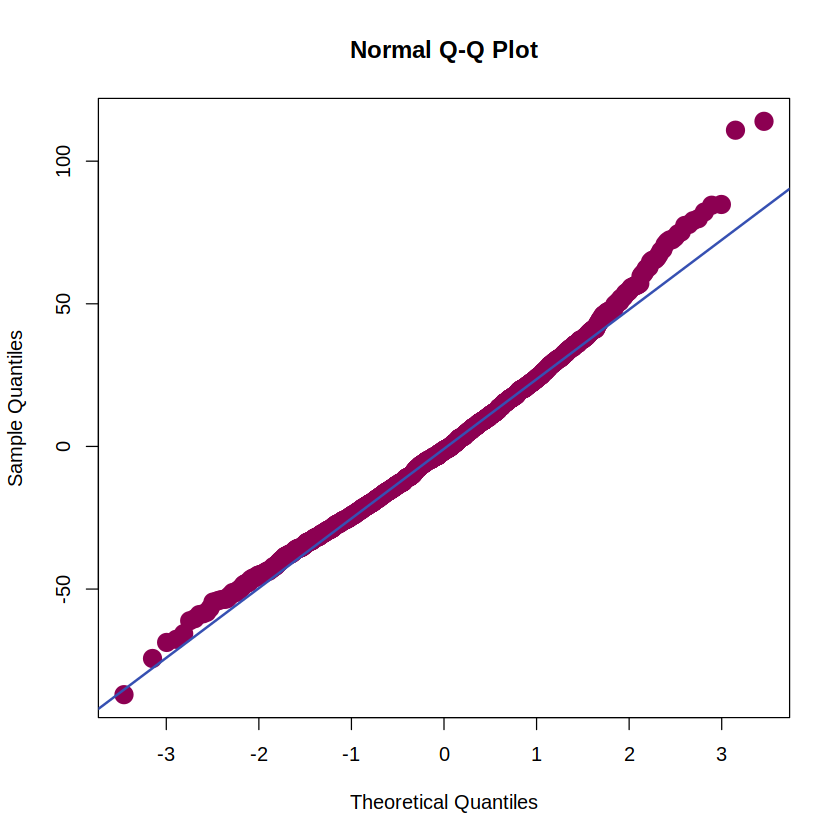

In [223]:
#Visualización
qqnorm(modelo_lm_inc$residuals,pch =19,col ="#8c0052", cex=2)
qqline(modelo_lm_inc$residuals , col = "#3650b2", lwd = 2 )  

# Statistical Test
shapiro.test(modelo_lm_inc$residuals)


	Shapiro-Wilk normality test

data:  modelo_lm_pub$residuals
W = 0.97671, p-value < 2.2e-16


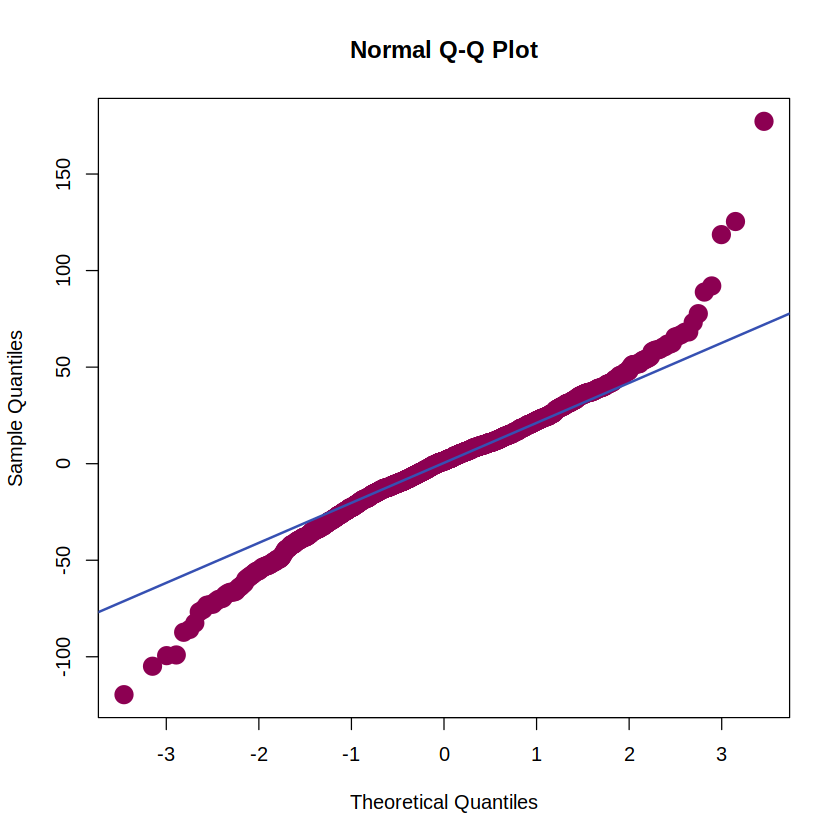

In [226]:
#Visualización
qqnorm(modelo_lm_pub$residuals,pch =19,col ="#8c0052", cex=2)
qqline(modelo_lm_pub$residuals , col = "#3650b2", lwd = 2 )  

# Statistical Test
shapiro.test(modelo_lm_pub$residuals)


	Shapiro-Wilk normality test

data:  modelo_lm_pov$residuals
W = 0.9785, p-value = 5.907e-16


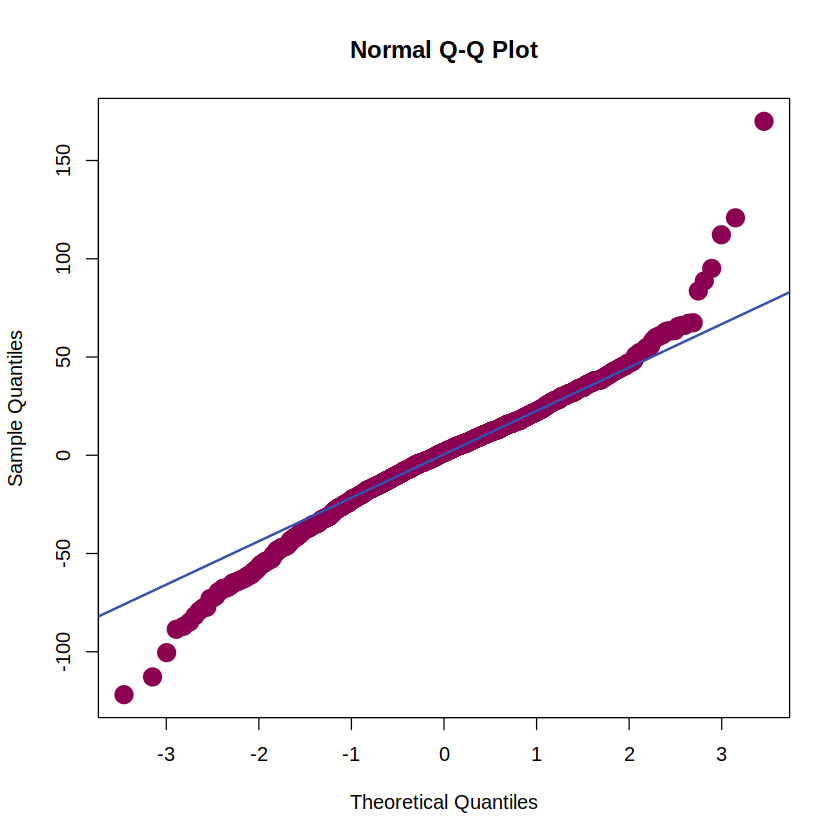

In [227]:
#Visualización
qqnorm(modelo_lm_pov$residuals,pch =19,col ="#8c0052", cex=2)
qqline(modelo_lm_pov$residuals , col = "#3650b2", lwd = 2 )  

# Statistical Test
shapiro.test(modelo_lm_pov$residuals)

Teniendo en cuenta los resultados del test, descartamos la hipotesis nula de que los errores se distribuyen normalmente. Dado, que todos los p value son inferiores al 0.05. Además podemos comprovar gracias a los gráficos que las distribuciones no se distribuyen normalmente.

## Homocedasticidad

- Hipotesis nula: los errores tienen varianza constante
- Hipotesis alternativa: los errores no tienen varianza constante

- Visualización: Residuos vs valores ajustados
- Prueba estadística: Breusch Pagan


	studentized Breusch-Pagan test

data:  modelo_lm_inc
BP = 3.1969, df = 1, p-value = 0.07378


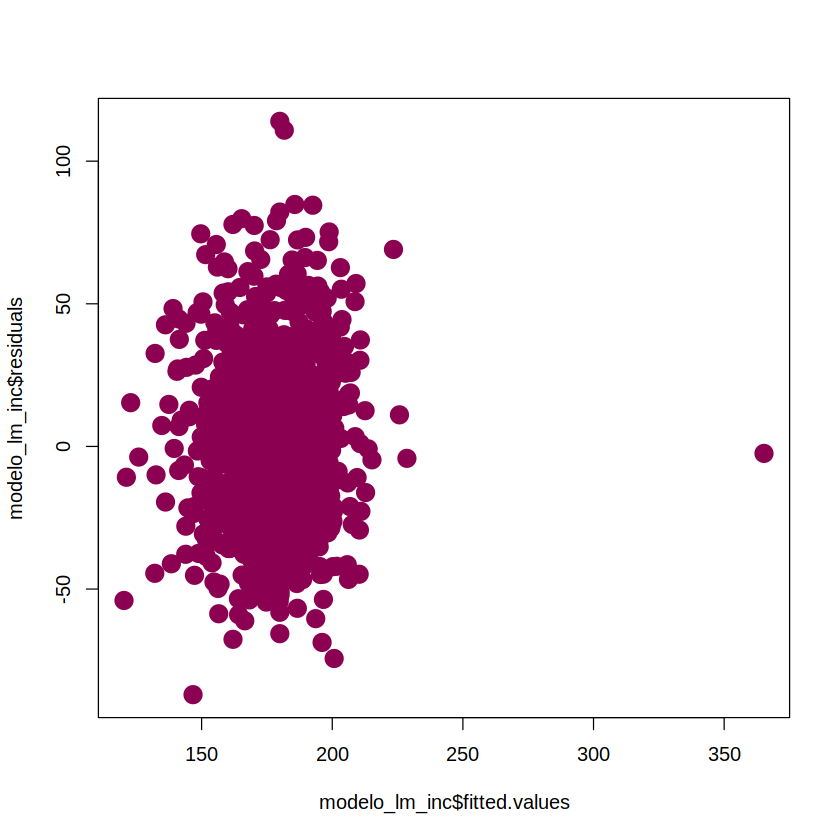

In [229]:
#Visualización

plot(modelo_lm_inc$fitted.values , modelo_lm_inc$residuals , pch =19,col ="#8c0052", cex=2 )

#Test estadístico

bptest(modelo_lm_inc)


	studentized Breusch-Pagan test

data:  modelo_lm_pub
BP = 41.146, df = 1, p-value = 1.413e-10


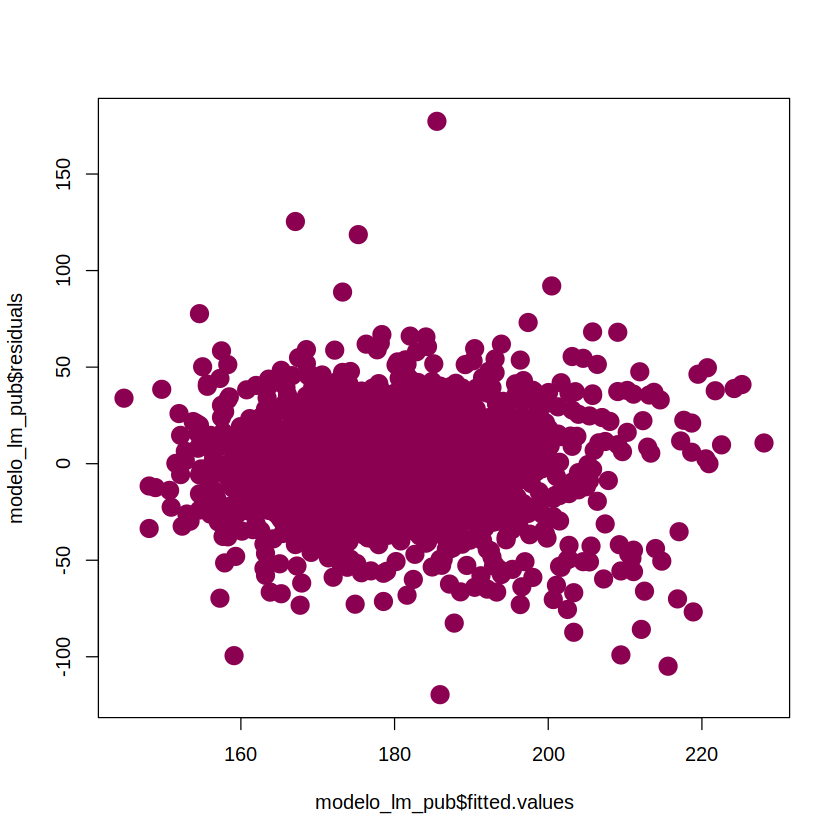

In [232]:
#Visualización

plot(modelo_lm_pub$fitted.values , modelo_lm_pub$residuals , pch =19,col ="#8c0052", cex=2 )

#Test estadístico

bptest(modelo_lm_pub)


	studentized Breusch-Pagan test

data:  modelo_lm_pov
BP = 57.104, df = 1, p-value = 4.133e-14


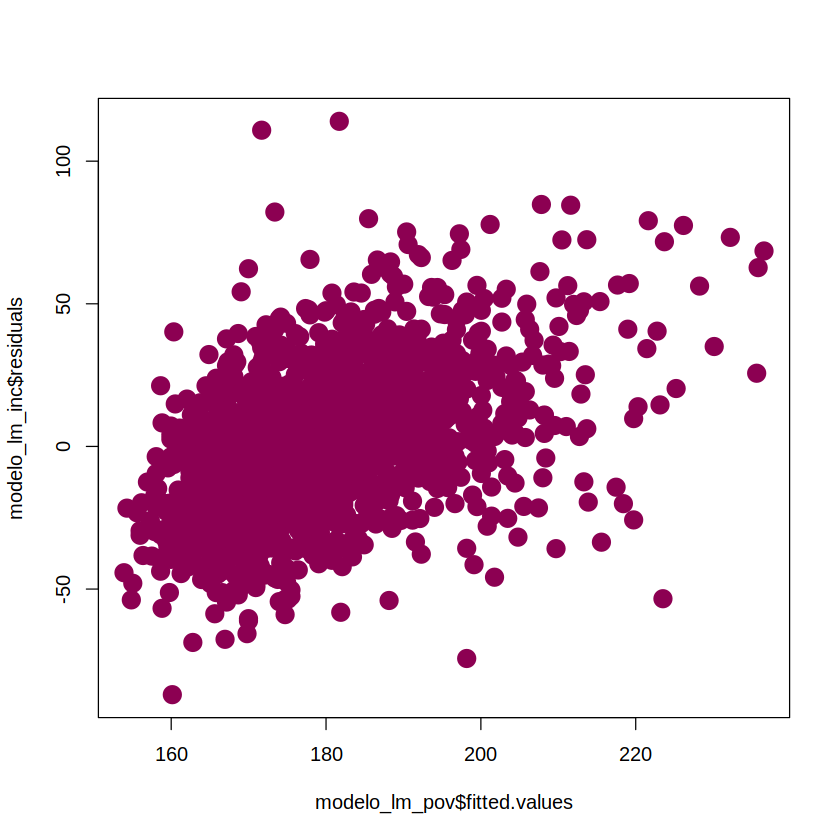

In [233]:
#Visualización

plot(modelo_lm_pov$fitted.values , modelo_lm_inc$residuals , pch =19,col ="#8c0052", cex=2 )

#Test estadístico

bptest(modelo_lm_pov)

Teniendo en cuenta que el p value de dos de los modelos (pobreza, sanidad publica) es inferior al 0.05, descartamos hipotesis nula de los mismos. Los errores no tienen varianza constante. Excepto la variable incidencerate que como podemos ver el p value es de 0.07, donde no podemos descartar que los errores tengan varianza constante.


## Autocorrelación
- Hipotesis nula: los errores no están correlacionados
- Hipotesis alternativa: los errores están correlacionados


- Visualización: Residuals vs Orden de toma de observaciones
- Prueba estadística: Durbin-Watson


	Durbin-Watson test

data:  modelo_lm_inc
DW = 1.5083, p-value < 2.2e-16
alternative hypothesis: true autocorrelation is not 0


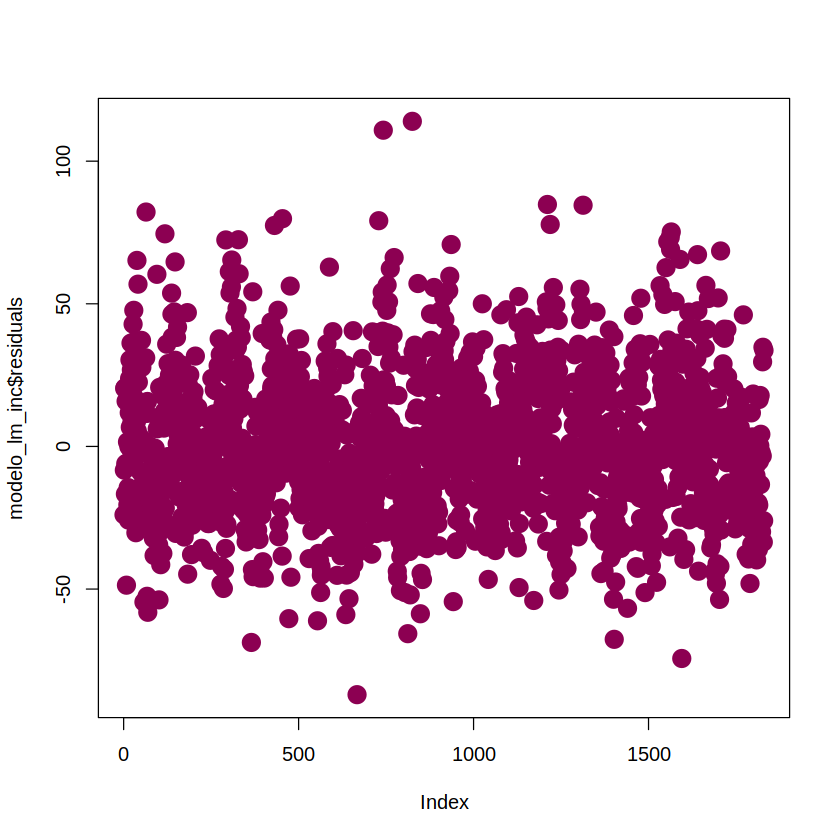

In [235]:
# Visualization
plot(modelo_lm_inc$residuals, pch =19,col ="#8c0052", cex=2)

# Statistical Test
dwtest(modelo_lm_inc,  alternative = c("two.sided"))


	Durbin-Watson test

data:  modelo_lm_pov
DW = 1.6078, p-value < 2.2e-16
alternative hypothesis: true autocorrelation is not 0


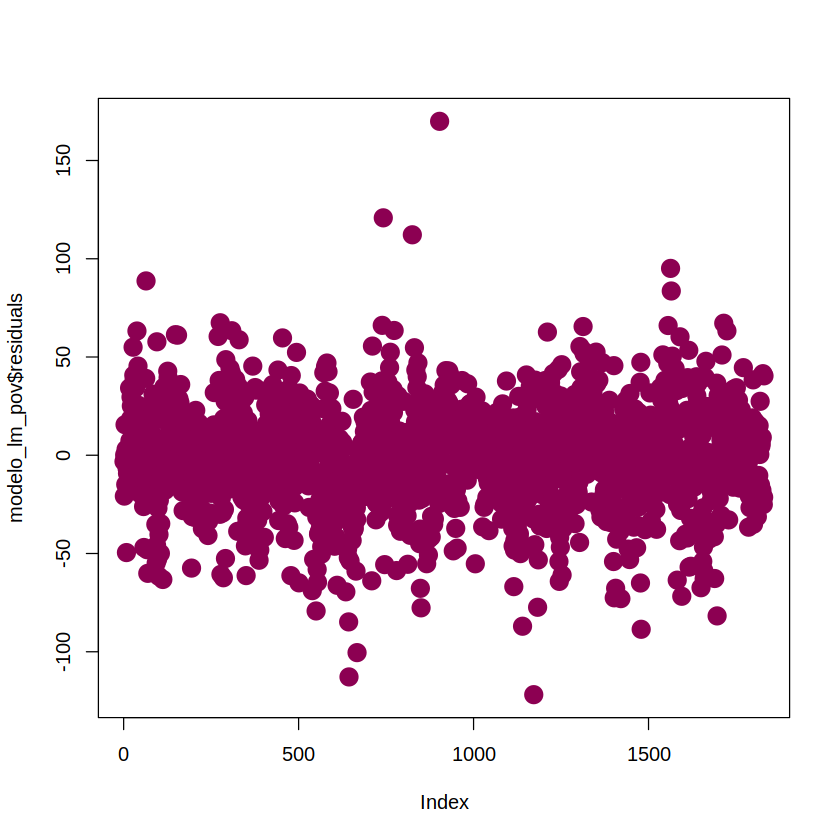

In [237]:
# Visualization
plot(modelo_lm_pov$residuals, pch =19,col ="#8c0052", cex=2)

# Statistical Test
dwtest(modelo_lm_pov,  alternative = c("two.sided"))


	Durbin-Watson test

data:  modelo_lm_pub
DW = 1.5416, p-value < 2.2e-16
alternative hypothesis: true autocorrelation is not 0


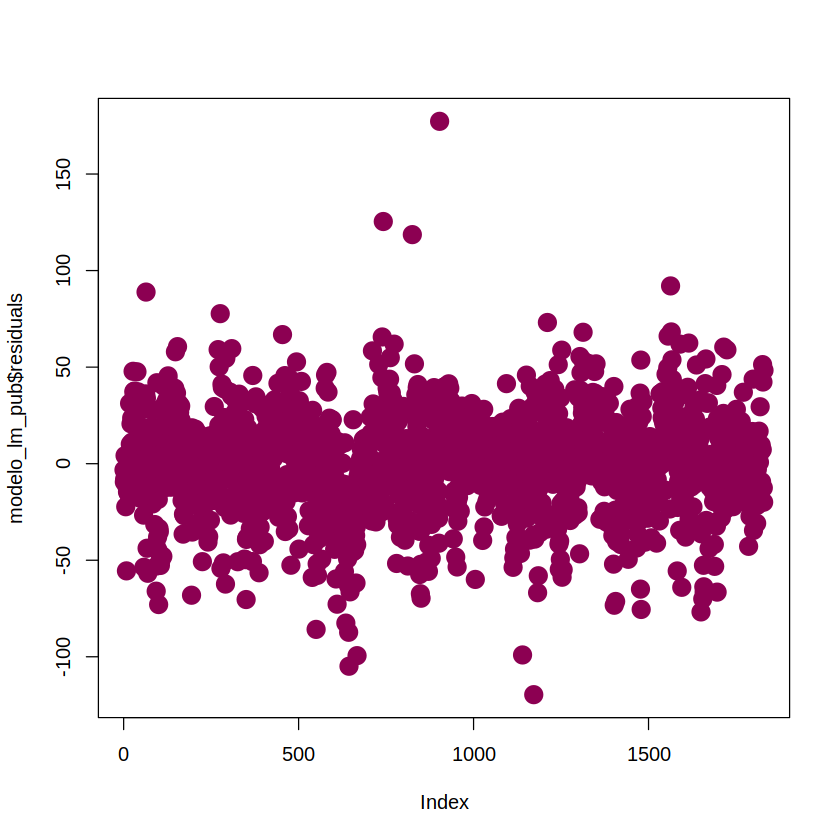

In [239]:
# Visualization
plot(modelo_lm_pub$residuals, pch =19,col ="#8c0052", cex=2)

# Statistical Test
dwtest(modelo_lm_pub,  alternative = c("two.sided"))

Teniendo en cuenta que el p value es inferior al 0.05, decartamos la hipotesis nula y podemos afirmar que los errores están relacionados. Contribuyendo a la no linealidad del conjunto.

## Media de errores

In [241]:
mean(modelo_lm_inc$residuals)

[1] 9.723078e-17

In [243]:
mean(modelo_lm_pub$residuals)

[1] 4.425194e-16

In [244]:
mean(modelo_lm_pov$residuals)

[1] 2.757736e-16

El resultado anterior muestra que los errores son muy cercanos a cero

## Detección de outliers

ERROR: Error in augment(modelo_lm_inc): could not find function "augment"


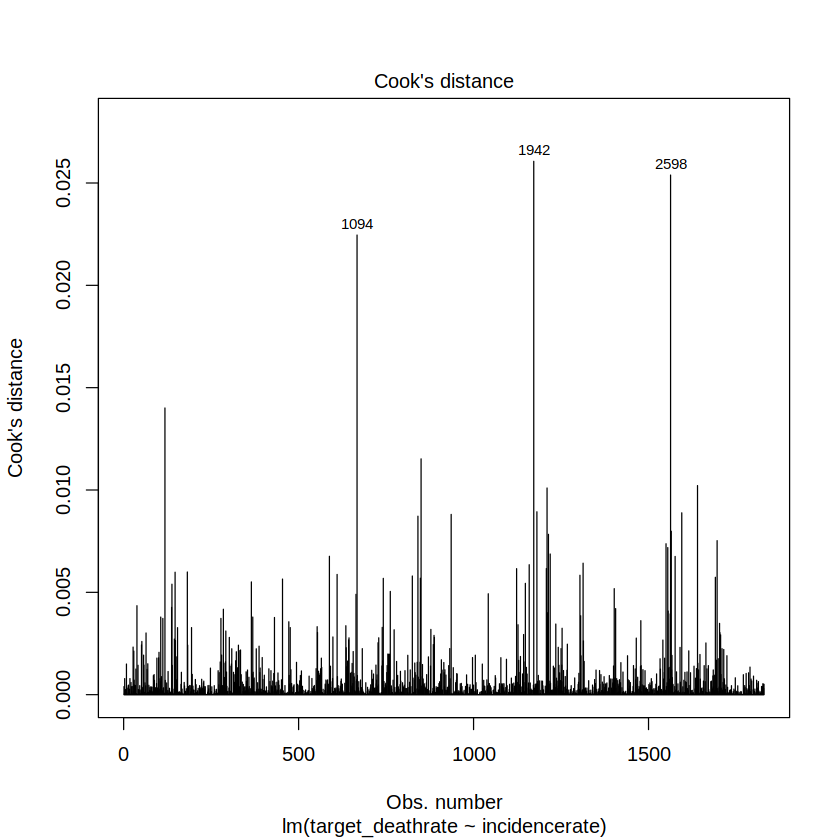

In [246]:
# Visualization (Cook's distance plot)
plot(modelo_lm_inc , 4)

# Statistical Measure: 
model_dm = augment(modelo_lm_inc)

ERROR: Error in augment(modelo_lm_pub): could not find function "augment"


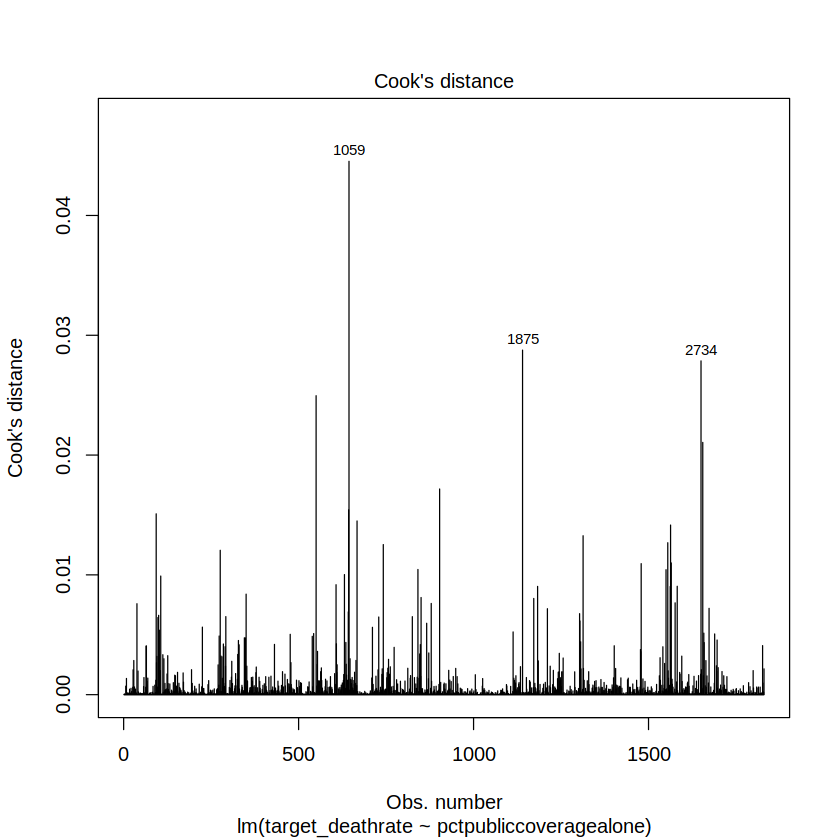

In [248]:
# Visualization (Cook's distance plot)
plot(modelo_lm_pub , 4)

# Statistical Measure: 
model_dm = augment(modelo_lm_pub)

ERROR: Error in augment(modelo_lm_pov): could not find function "augment"


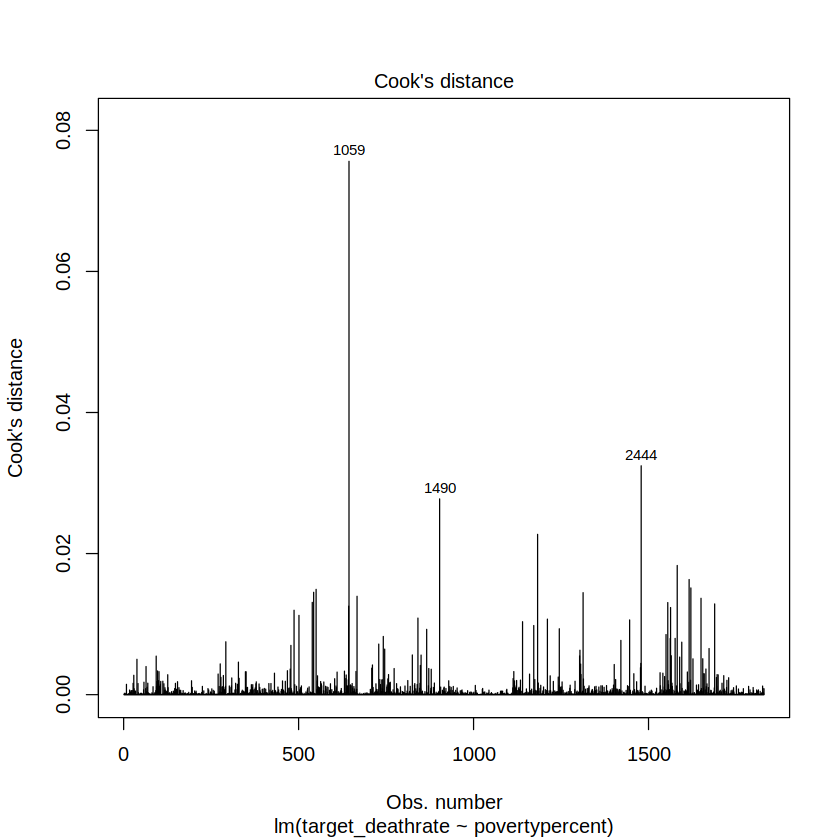

In [250]:
# Visualization (Cook's distance plot)
plot(modelo_lm_pov , 4)

# Statistical Measure: 
model_dm = augment(modelo_lm_pov)

Podemos comprovar en los gráficos anteriores la presencia de outliers que afectan a la linealidad del conjunto. Como se puede comprovar la función augment proporciona errores y no se pueden analizar los resultados esperados.

In [171]:
# Checking Highest Cook's distance
max(model_dm$.cooksd)

ERROR: Error in eval(expr, envir, enclos): object 'model_dm' not found


## PREDICCIONES

R2,RMSE,MAE
<dbl>,<dbl>,<dbl>
0.161953,24.7814,19.25577


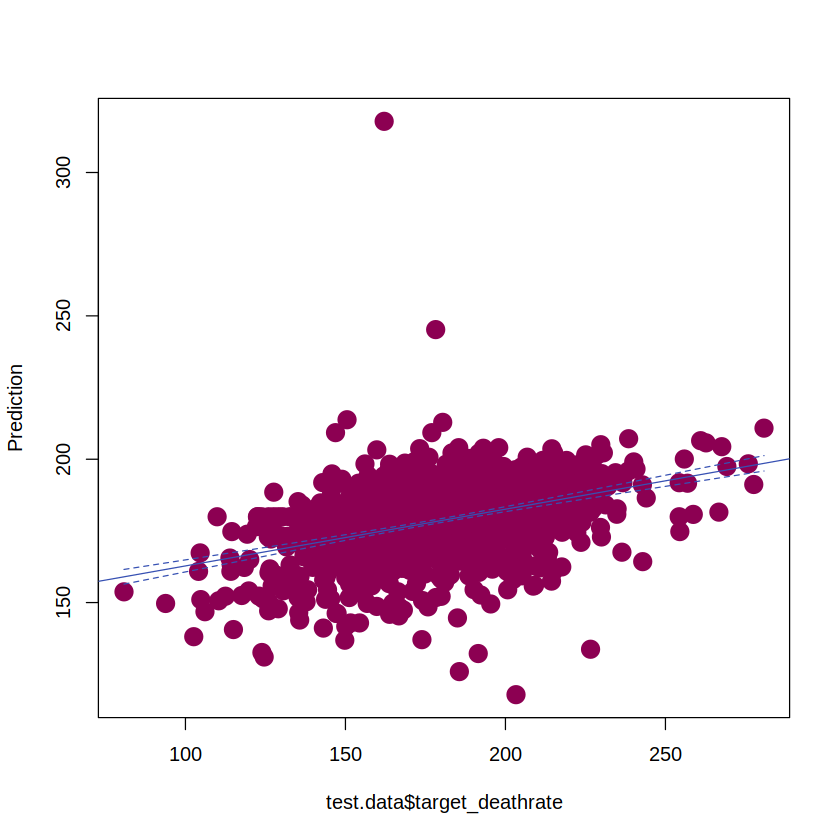

In [252]:
# Making prediction
prediction = predict(modelo_lm_inc, data_test)

### Visualization
plot(data_test$target_deathrate, prediction, xlab="test.data$target_deathrate", ylab="Prediction", pch =19,col ="#8c0052", cex=2)

#add fitted regression line
lm.out = lm(prediction ~ target_deathrate, data = data_test)
newx = seq(min(data_test$target_deathrate),max(data_test$target_deathrate),by = 0.05)
conf_interval = predict(lm.out, newdata=data.frame(target_deathrate=newx), interval="confidence", level = 0.95)
abline(lm.out, col = "#3650b2")

#add conf_interval lines
lines(newx, conf_interval[,2], col="#3650b2", lty=2)
lines(newx, conf_interval[,3], col="#3650b2", lty=2)

# Statistical Measure
data.frame( R2 = R2(prediction, data_test$target_deathrate),
            RMSE = RMSE(prediction, data_test$target_deathrate),
            MAE = MAE(prediction, data_test$target_deathrate))

R2,RMSE,MAE
<dbl>,<dbl>,<dbl>
0.2015244,24.07941,18.27915


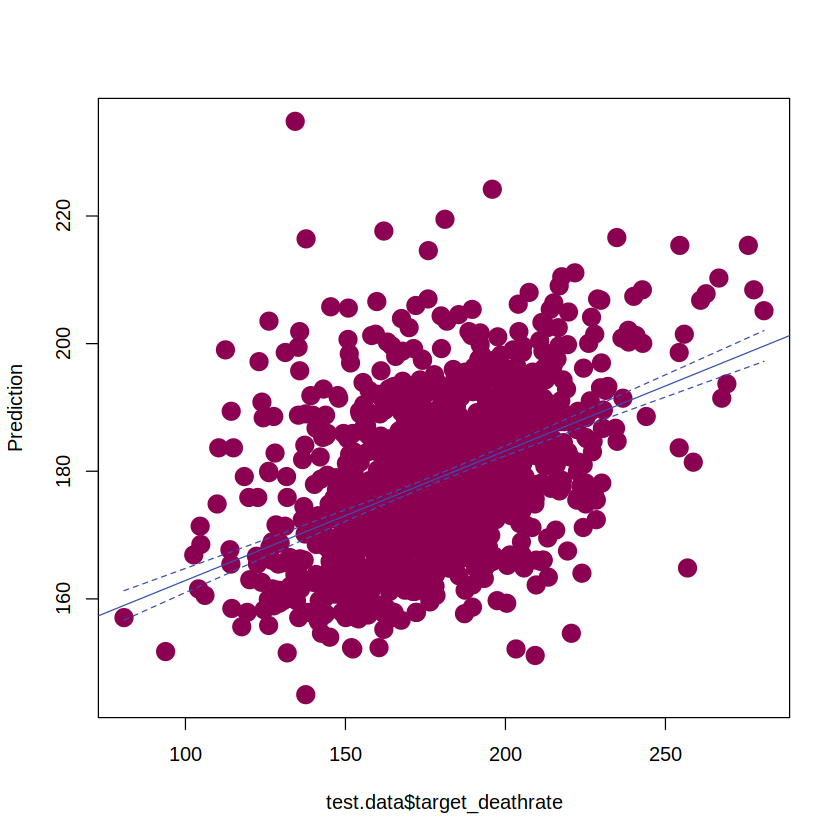

In [254]:
# Making prediction
prediction = predict(modelo_lm_pub, data_test)

### Visualization
plot(data_test$target_deathrate, prediction, xlab="test.data$target_deathrate", ylab="Prediction", pch =19,col ="#8c0052", cex=2)

#add fitted regression line
lm.out = lm(prediction ~ target_deathrate, data = data_test)
newx = seq(min(data_test$target_deathrate),max(data_test$target_deathrate),by = 0.05)
conf_interval = predict(lm.out, newdata=data.frame(target_deathrate=newx), interval="confidence", level = 0.95)
abline(lm.out, col = "#3650b2")

#add conf_interval lines
lines(newx, conf_interval[,2], col="#3650b2", lty=2)
lines(newx, conf_interval[,3], col="#3650b2", lty=2)

# Statistical Measure
data.frame( R2 = R2(prediction, data_test$target_deathrate),
            RMSE = RMSE(prediction, data_test$target_deathrate),
            MAE = MAE(prediction, data_test$target_deathrate))

R2,RMSE,MAE
<dbl>,<dbl>,<dbl>
0.1667153,24.60398,18.80864


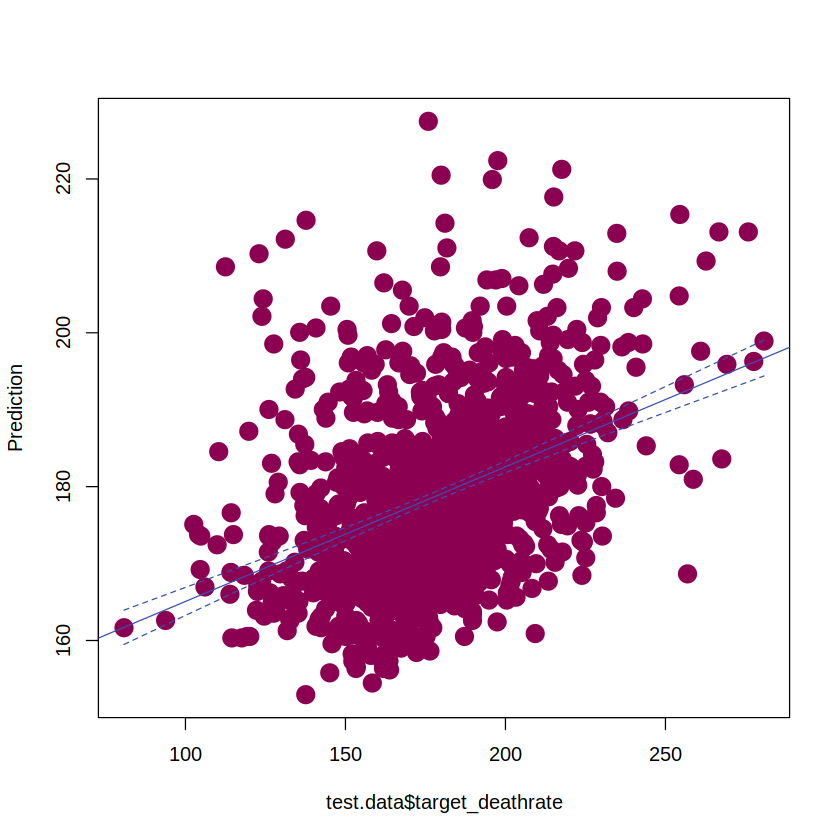

In [256]:
# Making prediction
prediction = predict(modelo_lm_pov, data_test)

### Visualization
plot(data_test$target_deathrate, prediction, xlab="test.data$target_deathrate", ylab="Prediction", pch =19,col ="#8c0052", cex=2)

#add fitted regression line
lm.out = lm(prediction ~ target_deathrate, data = data_test)
newx = seq(min(data_test$target_deathrate),max(data_test$target_deathrate),by = 0.05)
conf_interval = predict(lm.out, newdata=data.frame(target_deathrate=newx), interval="confidence", level = 0.95)
abline(lm.out, col = "#3650b2")

#add conf_interval lines
lines(newx, conf_interval[,2], col="#3650b2", lty=2)
lines(newx, conf_interval[,3], col="#3650b2", lty=2)

# Statistical Measure
data.frame( R2 = R2(prediction, data_test$target_deathrate),
            RMSE = RMSE(prediction, data_test$target_deathrate),
            MAE = MAE(prediction, data_test$target_deathrate))

# CONCLUSIONES

Como hemos visto al inicio del analisis, ninguna de las variables tiene linealidad con la variable dependiente y los tests que hemos realizado lo corroboran.

Hay que recordar que para un buen funcionamiento de una regresión lineal hay que cumplir los siguientes requisitos:
- Relación lineal entre las variables predictorias y la dependiente, ya hemos visto gracias a la matriz de cobarianza que tenian muy poca linealidad inferior en todos los casos 0.5. Además con el test realizado hemos comprovado que no podemos descartar la hipotesis que las variables tengan correlación 0.
- Los errores deben distribuirse normalmente, como hemos podido comprovar los errores no se distribuyen normalmente. Gracias al test realizado, hemos descartado la hipotesis de que los errores muestren una distribución normal.
- Homocedastricidad (los errores deben tener varianza constante), en este requerimiento gracias al test realizado, hemos demostrado como los errores no tienen varianza constante, excepto la variable incidence rate.
- Autocorrelación (los errores deben ser independientes y no deben estar correlacionados), después de realizar el test hemos descartado la hipotesis de que los errores eran independientes. Como consecuencia existe autocorrelación de las variables predictorias respecto a la dependiente.
- Los errores deben tener medias de cero, en este caso hemos obtenido un resultado positivo. La media de los errores es muy cercana a cero.
- Existencia de outliers, como hemos podido comprovar en las 3 variables predictorias existen outliers.

Como se puede ver, solo hemos cumplido uno de los requerimientos (media de los errores 0). Confirmando que el modelo de regresión lineal simple, no proporciona un resultado valido y de confianza para generar una predicción para este data set.


Una vez comprovado que los requerimientos no se cumplen, veamos el resultado de las predicciones:

- En las 3 variables obtenemos un valor de R2 muy cercano a cero, demostrando la no linealidad de las variables predictorias. Además podemos comprovar como los intervalos de confianza que nos muestran los gráficos, no representan el conjunto de datos de cada variable predictoria.

Como resultado final cerramos el analisis manifestanto que usando una regresión lineal simple y con las variables predictorias elegidas, no podemos realizar predicciones certeras y de fiabilidad de las muertes de cancer en los Estados Unidos por cada 100k habitantes.
De todos modos, podríamos decir que la variable que podría dar un mejor resultado dentro de los malos resultados es:

- Incidence rate, dado que proporciona mejor resultado en la homocedastricidad y en el test de media de errores cero. De todos modos, la variable pobreza es la que proporciona mejor resultado en la linealidad de la predicción aunque con poca diferencia.



La manera de realizar una predicción a través de estas variables sería con otro tipo de regresión que no fuera lineal.
